In [ ]:
%matplotlib widget

In [ ]:
from PIL import Image
import cv2 
import numpy as np
from IPython.display import display
import matplotlib.pyplot as plt

import ipywidgets as widgets
from ipywidgets import interact, HBox

import os
import sys
# sys.path.insert(0, os.path.abspath(os.path.join(os.path.dirname(__file__), '..')))
# os.path.abspath(os.path.join('..')
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

from cv2 import aruco
    
from scripts.util import extract_laser, undistort_camera


In [ ]:
import glob, os

aruco_samples = []
os.chdir("../res/pose_samples/blank_plane/")
for file in sorted(glob.glob("*"), key=os.path.getmtime):
    aruco_samples.append(file)

In [ ]:
def disp_file(path):
    # In OpenCV, images are in BGR
    # In Pillow, images are in RGB 
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    img = cv2.resize(img, (480, 360))
    display(Image.fromarray(img))

# Display cv2 image
def disp_img(cv_img):
#     cv_img = cv2.cvtColor(cv_img, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    cv_img = cv2.resize(cv_img, (480, 360))
    display(Image.fromarray(cv_img))

0 aruco_undist_0.png


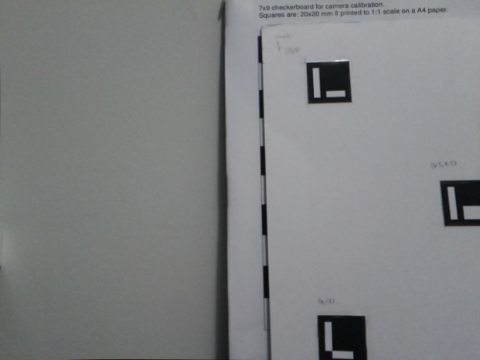

1 aruco_undist_1.png


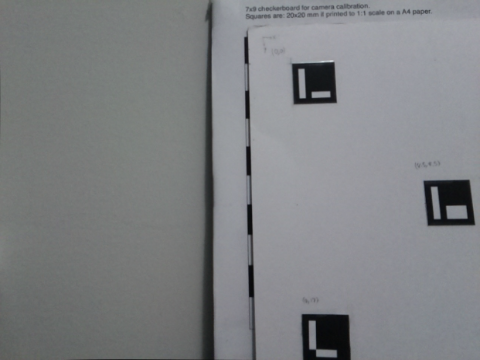

2 aruco_undist_10.png


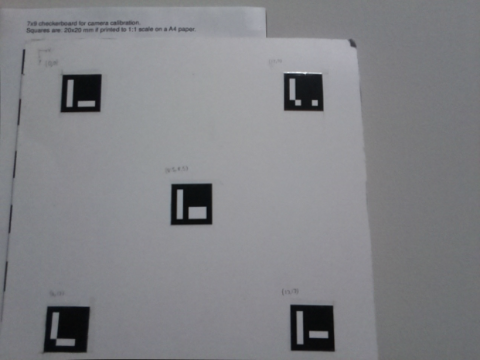

3 aruco_undist_11.png


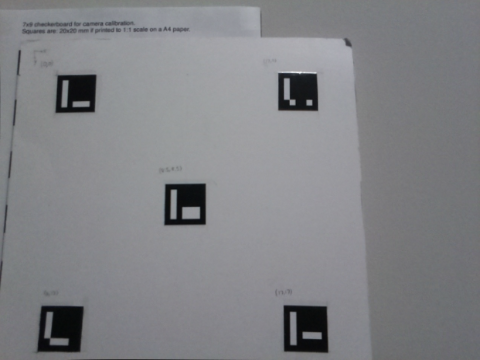

4 aruco_undist_12.png


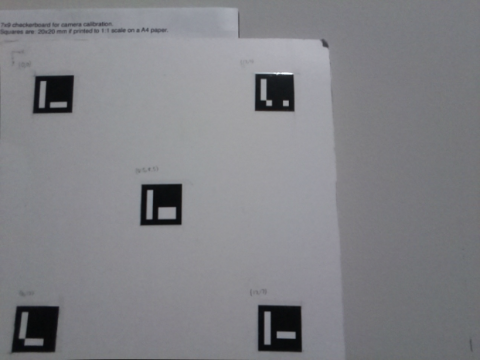

5 aruco_undist_13.png


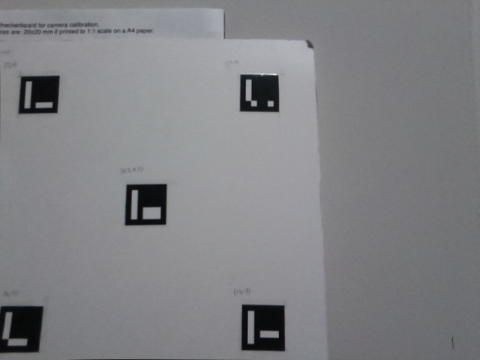

6 aruco_undist_15.png


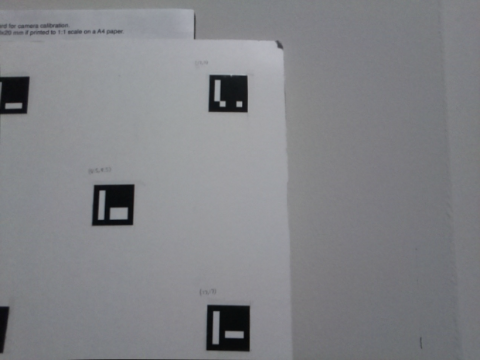

7 aruco_undist_14.png


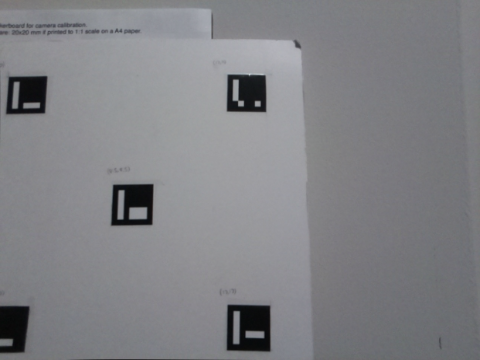

8 aruco_undist_16.png


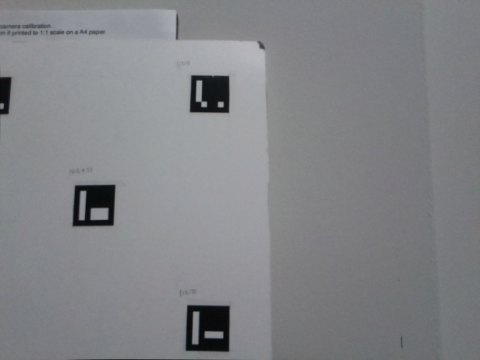

9 aruco_undist_18.png


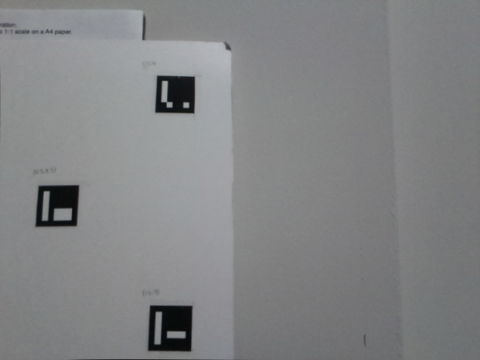

10 aruco_undist_17.png


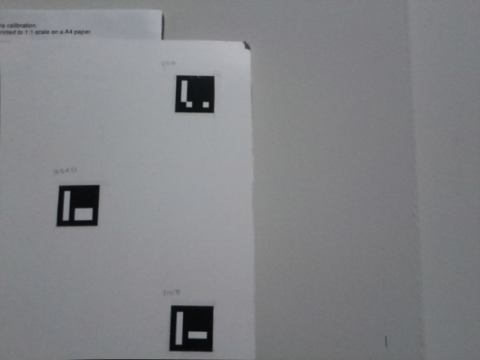

11 aruco_undist_2.png


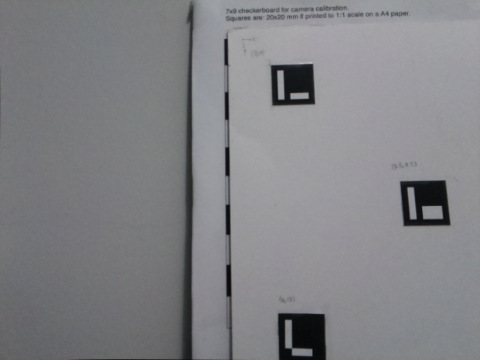

12 aruco_undist_19.png


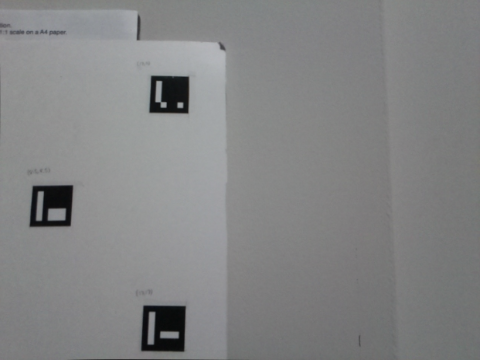

13 aruco_undist_20.png


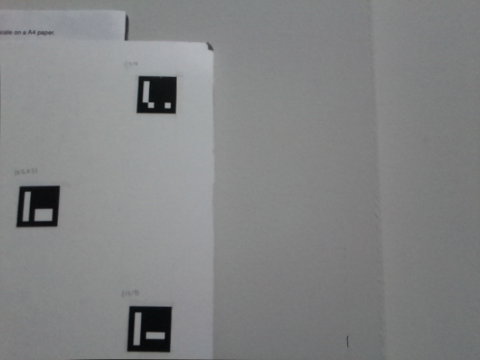

14 aruco_undist_21.png


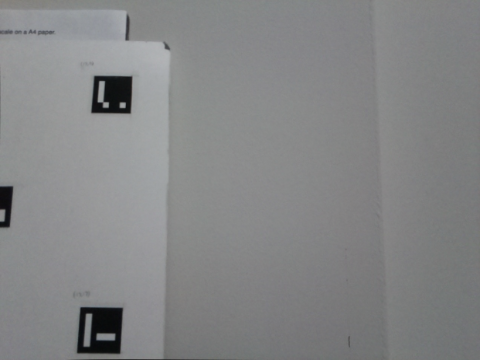

15 aruco_undist_23.png


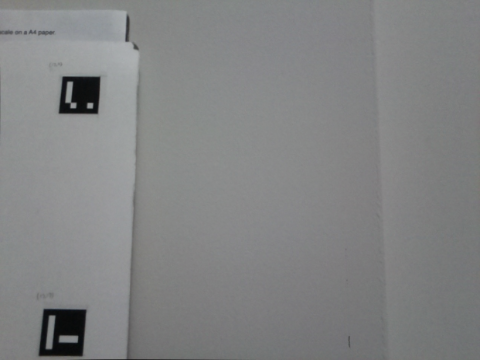

16 aruco_undist_22.png


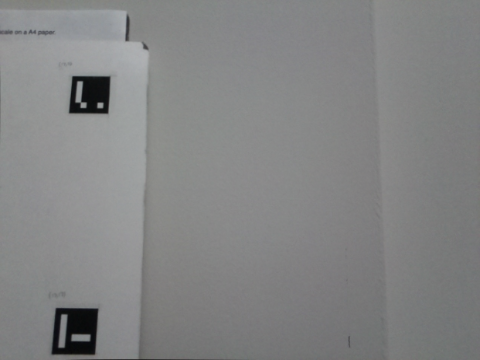

17 aruco_undist_24.png


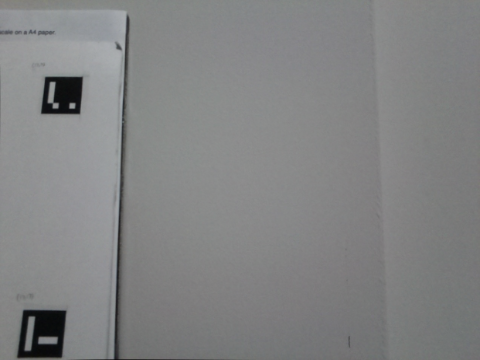

18 aruco_undist_25.png


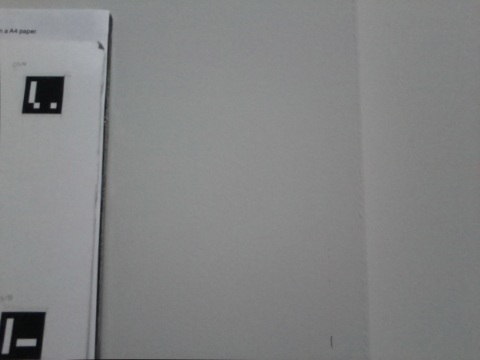

19 aruco_undist_27.png


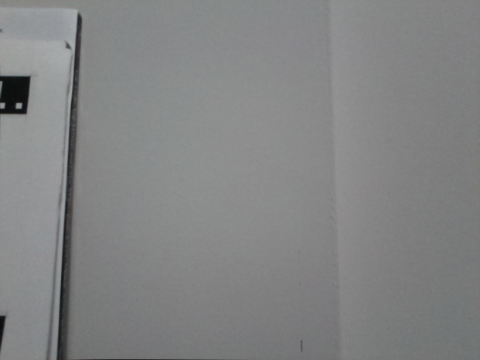

20 aruco_undist_26.png


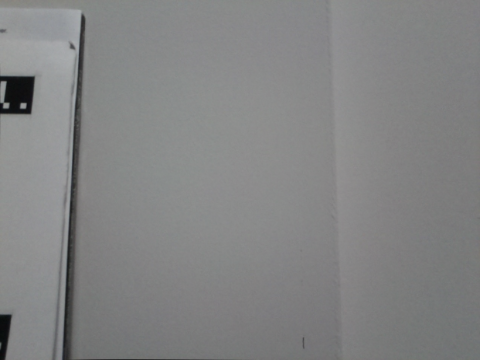

21 aruco_undist_4.png


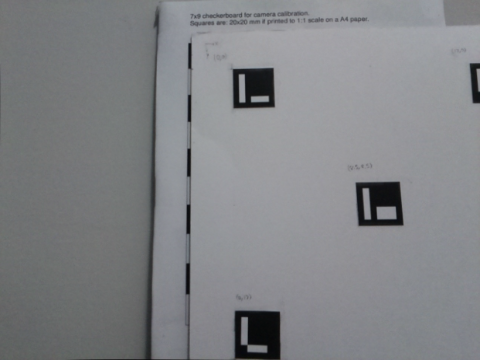

22 aruco_undist_3.png


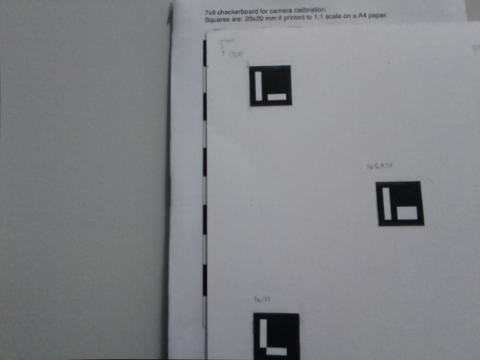

23 aruco_undist_6.png


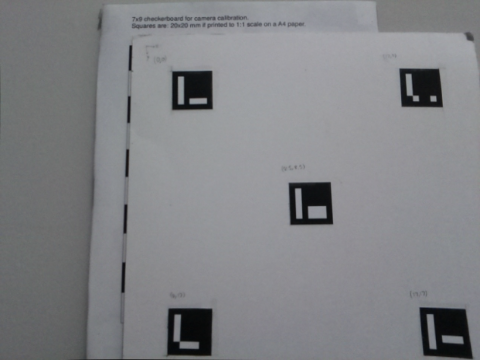

24 aruco_undist_5.png


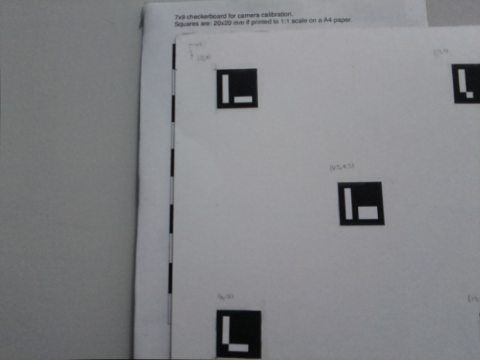

25 aruco_undist_7.png


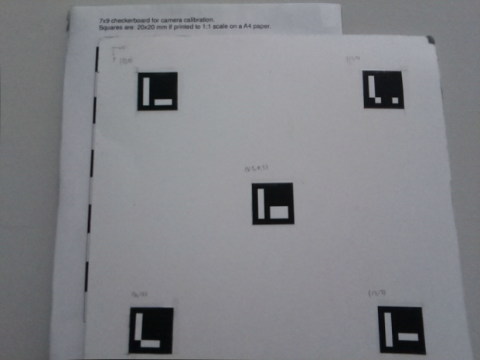

26 aruco_undist_8.png


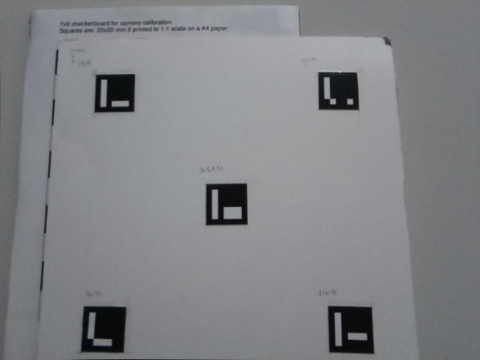

27 aruco_undist_9.png


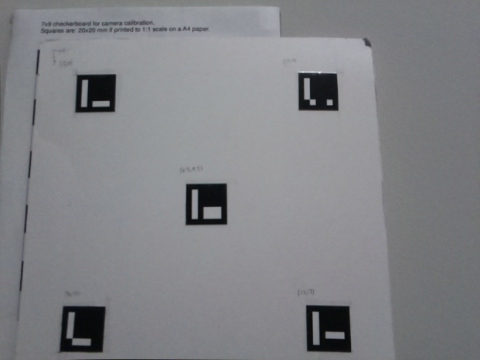

In [ ]:
for idx, f in enumerate(aruco_samples):
    print(idx, f)
    disp_file(f)

In [ ]:
# marker_31 = cv2.imread(laser_samples[31])
# marker_32 = cv2.imread(laser_samples[32])
# marker_33 = cv2.imread(laser_samples[33])
# marker_34 = cv2.imread(laser_samples[34])

# marker_31 = cv2.cvtColor(marker_31, cv2.COLOR_BGR2GRAY)
# marker_32 = cv2.cvtColor(marker_32, cv2.COLOR_BGR2GRAY)
# marker_33 = cv2.cvtColor(marker_33, cv2.COLOR_BGR2GRAY)
# marker_34 = cv2.cvtColor(marker_34, cv2.COLOR_BGR2GRAY)

In [ ]:
# fig, (ax1,ax2, ax3, ax4) = plt.subplots(nrows=1,ncols=4,figsize=(10,2))

# ax1.imshow(marker_31, cmap = plt.get_cmap('gray'))
# ax1.set_title("Image 1")
# ax2.imshow(marker_32, cmap = plt.get_cmap('gray'))
# ax2.set_title("Image 2")
# ax3.imshow(marker_33, cmap = plt.get_cmap('gray'))
# ax3.set_title("Image 3")
# ax4.imshow(marker_34, cmap = plt.get_cmap('gray'))
# ax4.set_title("Image 4")

# plt.show()

In [ ]:
imgs = []
for f in aruco_samples:
    img = cv2.imread(f)
    imgs.append(img)
    
    
mult_images = [i for idx, i in enumerate(imgs)]



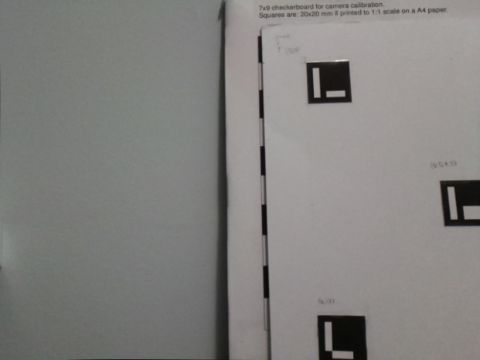

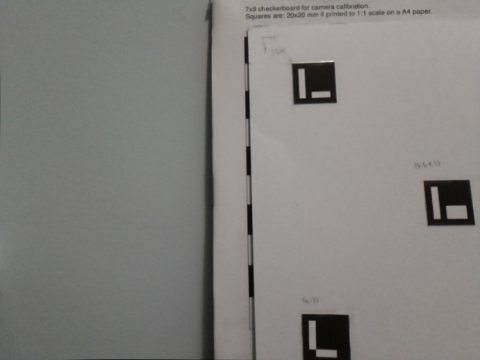

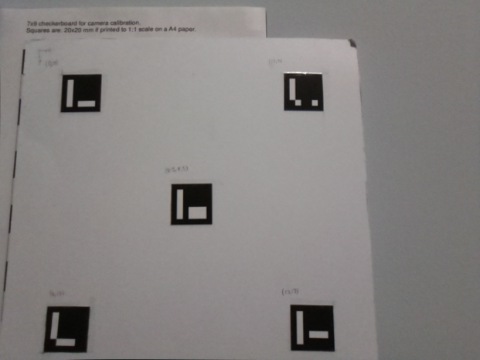

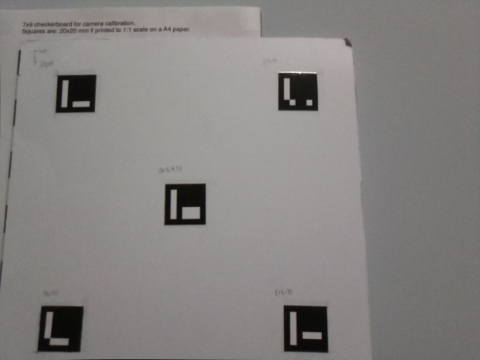

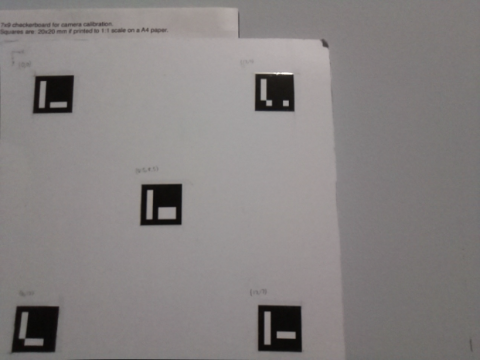

...

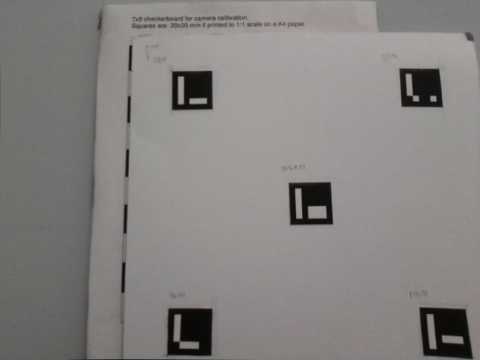

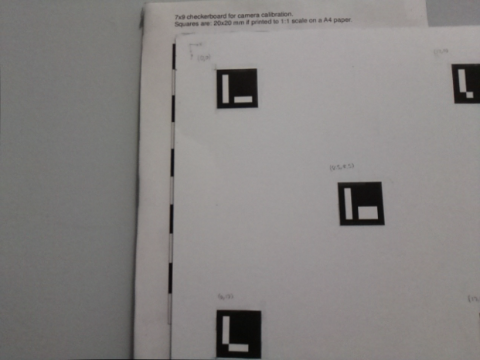

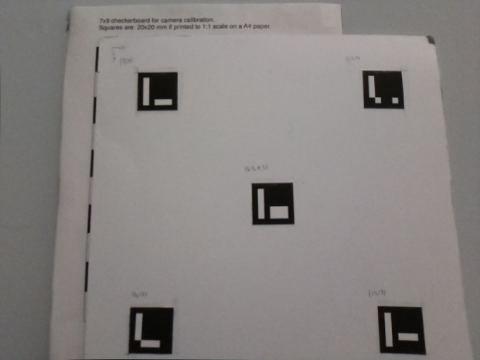

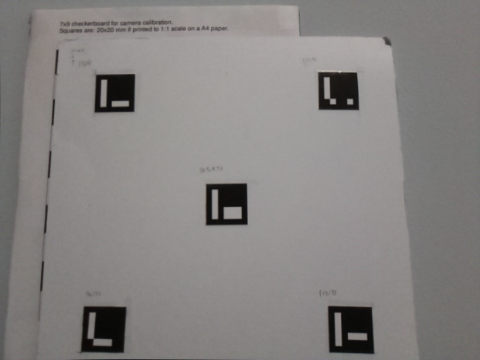

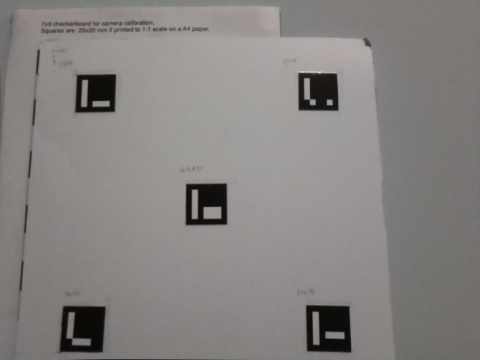

In [ ]:
for i in imgs:
    disp_img(i)

# Load Camera Matrix

In [ ]:
os.chdir("../../../")
print(os.getcwd())

/home/abhi/Code/3D-Scanner


In [ ]:
with np.load('res/cal_out/cam_params.npz') as X:
    camera_matrix, dist_coeffs = [X[i] for i in ('mtx','dist')]

# Get pose of an image

In [ ]:
def customAruco():
    # define an empty custom dictionary with 
    aruco_dict = cv2.aruco.custom_dictionary(0, 5, 1)
    # add empty bytesList array to fill with 3 markers later
    aruco_dict.bytesList = np.empty(shape = (5, 4, 4), dtype = np.uint8)
    # add new marker(s)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1]], dtype = np.uint8)
    aruco_dict.bytesList[0] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[0,1,0,0,1]], dtype = np.uint8)
    aruco_dict.bytesList[1] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[0,1,1,1,0]], dtype = np.uint8)
    aruco_dict.bytesList[2] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1],[1,0,0,0,0]], dtype = np.uint8)
    aruco_dict.bytesList[3] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1],[1,0,1,1,1]], dtype = np.uint8)
    aruco_dict.bytesList[4] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    # adjust dictionary parameters for better marker detection
    parameters =  cv2.aruco.DetectorParameters_create()
    parameters.cornerRefinementMethod = 3
    parameters.errorCorrectionRate = 0.2
    return aruco_dict, parameters

In [ ]:
frame = imgs[0]

In [ ]:
aruco_dict, arucoParams = customAruco()

In [ ]:
h,w = 480, 640
new_mtx, roi = cv2.getOptimalNewCameraMatrix(camera_matrix,dist_coeffs,(w,h),1,(w,h))

In [ ]:
# frame = undistort_camera(frame, camera_matrix, new_mtx, roi, dist_coeffs, w, h)
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

In [ ]:
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)

In [ ]:
frame_rvecs = []
frame_tvecs = []

for i in range(0, len(ids)):  
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawDetectedMarkers(frame, corners, ids)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

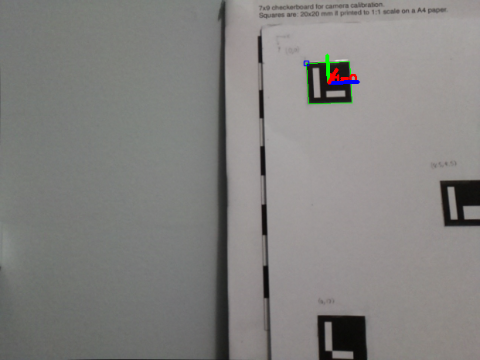

In [ ]:
disp_img(frame)

# Get relative transformations between markers

In [ ]:
# Transform from X to 0 where 0 is the marker placed at top left corner
frame = imgs[2]
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)
frame_rvecs = []
frame_tvecs = []

marker_order = {}

In [ ]:
for i in range(0, len(ids)):
    marker_order[ids[i][0]] = i
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

frame = cv2.aruco.drawDetectedMarkers(frame, corners, ids)

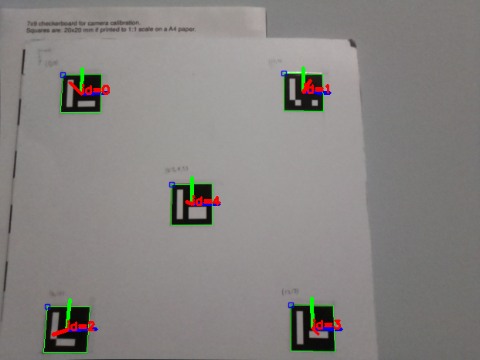

In [ ]:
disp_img(frame)

In [ ]:
print(ids)
print(marker_order)

[[1]
 [2]
 [3]
 [4]
 [0]]
{1: 0, 2: 1, 3: 2, 4: 3, 0: 4}


In [ ]:
t_1_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[1]]).flatten()
t_2_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[2]]).flatten()
t_3_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[3]]).flatten()
t_4_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[4]]).flatten()

print(t_1_0) 
print(t_2_0)  
print(t_3_0)
print(t_4_0)

[-17.03332392   0.07640195   0.48512037]
[ -0.20607315 -16.85089935   3.16841939]
[-17.18770291 -16.88283019   2.98734751]
[-8.58334423 -8.3571146   1.89874822]


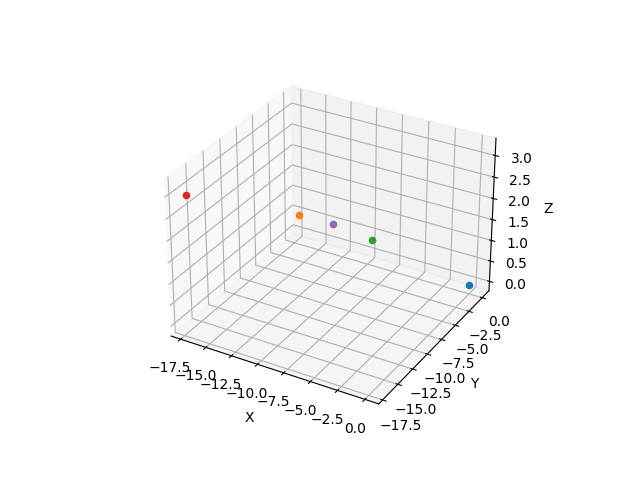

In [ ]:
tpts = [np.array([0, 0,0]), t_1_0, t_2_0, t_3_0, t_4_0]

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')

for pt in tpts:
    ax.scatter(pt[0],pt[1],pt[2])

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.show()

In [ ]:
#https://stackoverflow.com/questions/51270649/aruco-marker-world-coordinates



# Get pose of camera with one marker

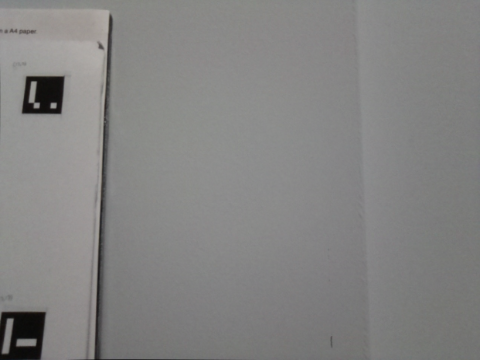

In [ ]:
frame = imgs[18]
disp_img(frame)

In [ ]:
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)
frame_rvecs = []
frame_tvecs = []

marker_order = {}

In [ ]:
print(ids)

[[1]]


In [ ]:
for i in range(0, len(ids)):
    marker_order[ids[i][0]] = i
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

frame = cv2.aruco.drawDetectedMarkers(frame, corners, ids)

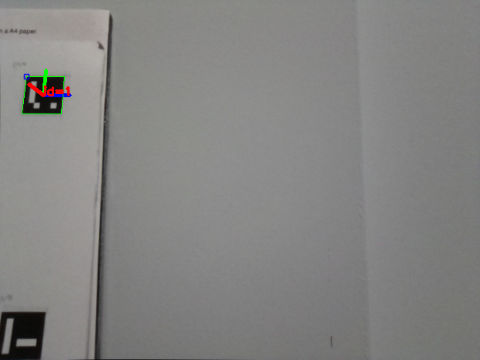

In [ ]:
disp_img(frame)

In [ ]:
#temporary changes so that we only work with one marker
rvec = frame_rvecs[0].flatten()
tvec = frame_tvecs[0].flatten()

print(rvec)
print(tvec)

[ 2.94825035  0.01078355 -0.06987148]
[-14.36840034  -5.97024325  29.91164026]


In [ ]:
dst, jac = cv2.Rodrigues(rvec)

print(dst)

[[ 0.99886121  0.01177606 -0.04623436]
 [ 0.00271093 -0.98150353 -0.19142484]
 [-0.04763342  0.19108151 -0.98041772]]


In [ ]:
extrinsics = np.eye(4)
extrinsics[:3, :3] = dst
extrinsics[:3, 3] = tvec

ex_i = np.linalg.inv(extrinsics)

print(extrinsics)
print("-------------------------------------------------------------------------------------")
print(ex_i)
print("-------------------------------------------------------------------------------------")
print(ex_i@extrinsics)
print("-------------------------------------------------------------------------------------")

# Alternative way to get inverse of 4x4 
ht = np.eye(4)
ht[:3, :3] = dst.transpose()
ht[:3, 3] = -dst.transpose()@tvec

print(ht)

[[ 9.98861206e-01  1.17760626e-02 -4.62343604e-02 -1.43684003e+01]
 [ 2.71092907e-03 -9.81503531e-01 -1.91424842e-01 -5.97024325e+00]
 [-4.76334189e-02  1.91081511e-01 -9.80417724e-01  2.99116403e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
-------------------------------------------------------------------------------------
[[ 9.98861206e-01  2.71092907e-03 -4.76334189e-02  1.57930163e+01]
 [ 1.17760626e-02 -9.81503531e-01  1.91081511e-01 -1.14061731e+01]
 [-4.62343604e-02 -1.91424842e-01 -9.80417724e-01  2.75187356e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
-------------------------------------------------------------------------------------
[[ 1.00000000e+00 -1.67911222e-18  1.00398075e-17  1.77635684e-15]
 [-1.68291359e-18  1.00000000e+00 -2.90061864e-18  0.00000000e+00]
 [ 9.90392820e-18 -3.01126769e-17  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
---------------------

### Plotting transformed point from camera frame to world frame

[[ 0.96440291]
 [-1.17021744]
 [-0.83696963]
 [32.90557883]]


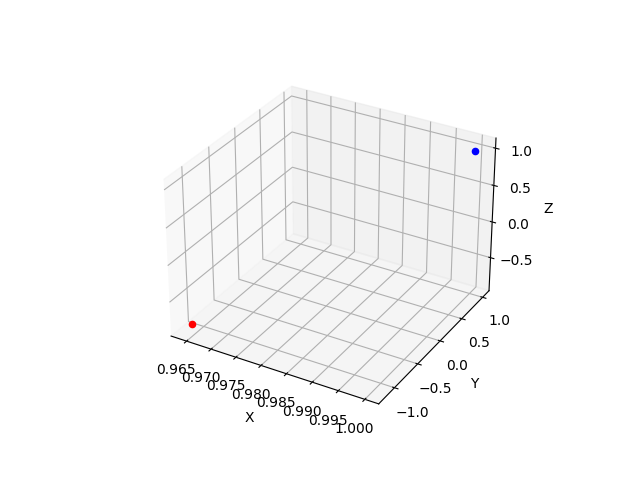

In [ ]:
point = np.array([[1],[1],[1],[1]]).reshape(4,1)
# tf_point = ex_i@point
tf_point = (point.transpose()@ex_i).transpose()
print(tf_point)
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')

ax.scatter(point[0], point[1], point[2], color='blue')
ax.scatter(tf_point[0], tf_point[1], tf_point[2], color='red')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.show()

# Get pose of camera over multiple images (for top left marker only)

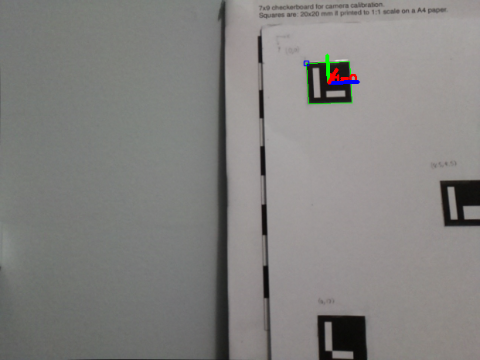

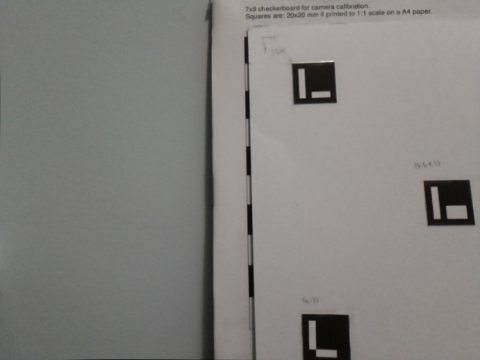

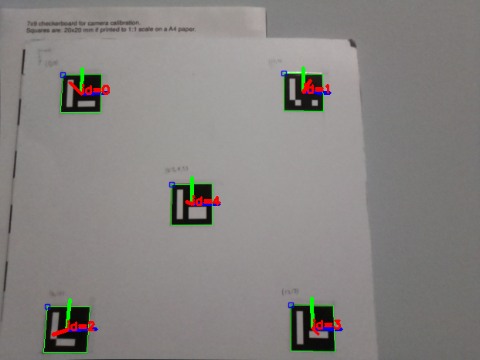

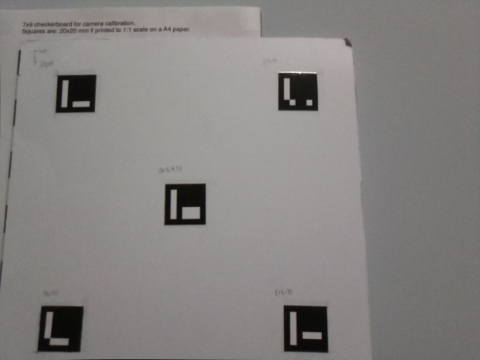

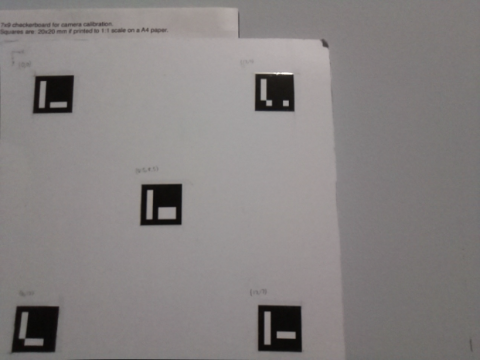

...

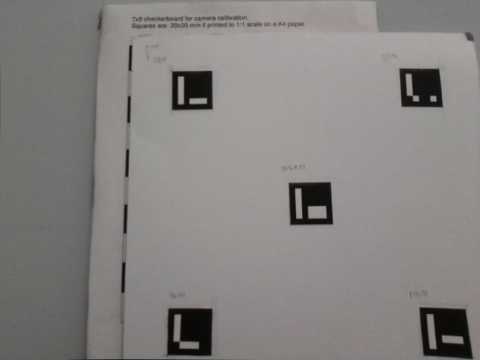

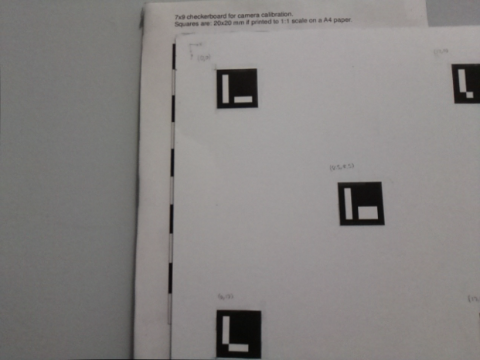

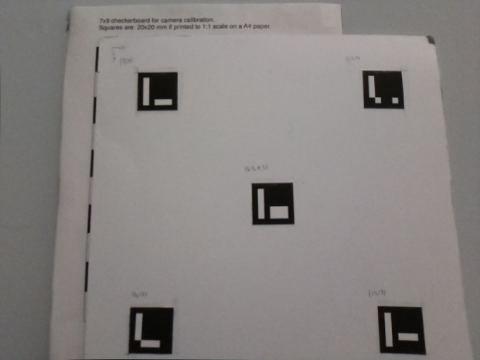

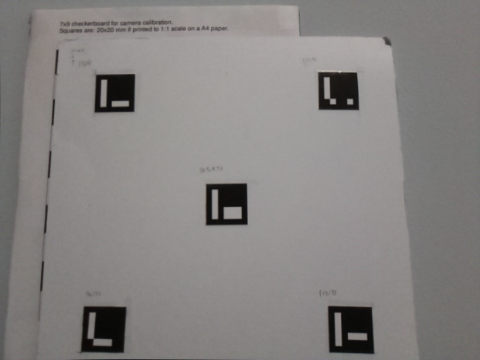

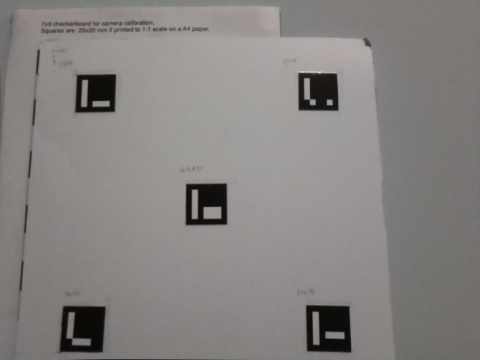

In [36]:
mult_images = [i for idx, i in enumerate(imgs)]

for frame in mult_images:
    disp_img(frame)

In [37]:
ids

array([[1]], dtype=int32)

In [38]:
# mult_images = [i for idx, i in enumerate(imgs)]

# These contain rot and trans vectors of marker 0 for each image
frame_rvecs = []
frame_tvecs = []

for frame in mult_images:
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)
    if ids is not None:
        # disp_img(frame)
        test_img = 0
        for i in range(0, len(ids)):        
            if ids[i][0] == 0:
                rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
                frame_rvecs.append(rvec)
                frame_tvecs.append(tvec)
                # test_img = cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

        # test_img = cv2.aruco.drawDetectedMarkers(frame, corners, ids)
        # disp_img(test_img)


    

In [39]:
def get_itf(rvec, tvec):
    dst, jac = cv2.Rodrigues(rvec)
    extrinsics = np.eye(4)
    extrinsics[:3, :3] = dst
    extrinsics[:3, 3] = tvec
    return np.linalg.inv(extrinsics)

In [40]:
coord_tf = []

for idx, rvec in enumerate(frame_rvecs):
    coord_tf.append(get_itf(rvec.flatten(), frame_tvecs[idx].flatten()))
    
print(coord_tf[0])


[[ 9.99432011e-01 -2.38443529e-02 -2.38138999e-02 -5.34133798e+00]
 [-1.94821259e-02 -9.85416257e-01  1.69042147e-01 -1.07962424e+01]
 [-2.74973047e-02 -1.68482188e-01 -9.85321090e-01  2.60604293e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


In [41]:
pts = np.array([[1, 1, 1],
          [2, 2, 2],
          [3, 3, 3],
          [4, 4, 4],
          [5, 5, 5],
         ])

[[ 0.95245258]
 [-1.1777428 ]
 [-0.84009284]
 [10.9228489 ]]
[[ -4.38956422]
 [-11.63209861]
 [ 24.87912867]
 [  1.        ]]
[[ 0.92650525]
 [-1.18567887]
 [-0.85776083]
 [30.55820727]]
[[ 14.22463934]
 [-12.30408688]
 [ 26.52072036]
 [  1.        ]]
[[ 0.92742969]
 [-1.19181966]
 [-0.84819813]
 [31.87918714]]
[[ 15.88406205]
 [-12.46879632]
 [ 26.35133332]
 [  1.        ]]
[[ 0.96105147]
 [-1.17132586]
 [-0.839271  ]
 [33.64008794]]
[[ 16.29061475]
 [-12.06981011]
 [ 27.3697379 ]
 [  1.        ]]
[[ 0.95010955]
 [-1.19205147]
 [-0.82237774]
 [33.6435654 ]]
[[ 17.16577264]
 [-12.55959249]
 [ 26.97306559]
 [  1.        ]]
[[ 0.94570806]
 [-1.1830217 ]
 [-0.84029514]
 [12.53898097]]
[[ -2.63663642]
 [-11.84920059]
 [ 24.9472092 ]
 [  1.        ]]
[[ 0.9538501 ]
 [-1.1909463 ]
 [-0.81964437]
 [15.19328316]]
[[ -0.16082054]
 [-12.16883777]
 [ 25.46620091]
 [  1.        ]]
[[ 0.97163013]
 [-1.18664798]
 [-0.80486114]
 [13.08341401]]
[[ -1.70529496]
 [-12.02760791]
 [ 24.7964379 ]
 [  1.   

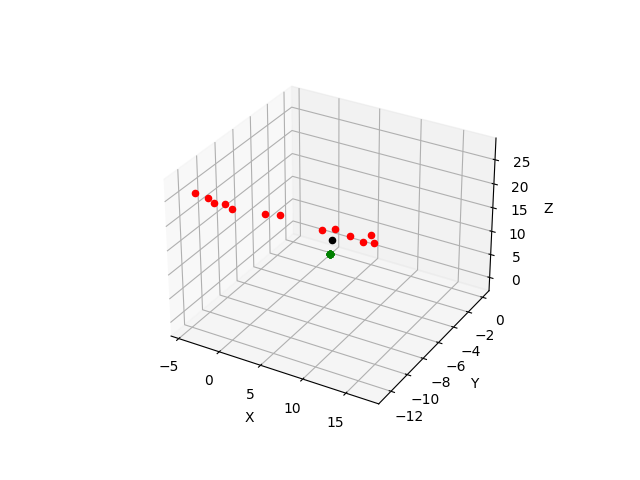

In [42]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

# ax.scatter(tf_point[0], tf_point[1], tf_point[2], color='blue')
ax.scatter(0,0,0, color='black')

for tf in coord_tf:    
    point = np.array([[1],[1],[1],[1]]).reshape(4,1)
    tf_point = (point.transpose()@tf).transpose()
    tf_point_2 = tf@point
    
    print(tf_point)
    print(tf_point_2)
    
    ax.scatter(tf_point[0], tf_point[1], tf_point[2], color='green')
    ax.scatter(tf_point_2[0], tf_point_2[1], tf_point_2[2], color='red')

plt.show()

In [43]:
def TransformBetweenMarkers(tvec_m, tvec_n, rvec_m, rvec_n):
    tvec_m = np.transpose(tvec_m) # tvec of 'm' marker
    tvec_n = np.transpose(tvec_n) # tvec of 'n' marker
    dtvec = tvec_m - tvec_n # vector from 'm' to 'n' marker in the camera's coordinate system

    # get the markers' rotation matrices respectively
    R_m = cv2.Rodrigues(rvec_m)[0]
    R_n = cv2.Rodrigues(rvec_n)[0]

    tvec_mm = np.matmul(-R_m.T, tvec_m) # camera pose in 'm' marker's coordinate system
    tvec_nn = np.matmul(-R_n.T, tvec_n) # camera pose in 'n' marker's coordinate system

    # translational difference between markers in 'm' marker's system,
    # basically the origin of 'n'
    dtvec_m = np.matmul(-R_m.T, dtvec)

    # this gets me the same as tvec_mm,
    # but this only works, if 'm' marker is seen
    # tvec_nm = dtvec_m + np.matmul(-R_m.T, tvec_n)

    # something with the rvec difference must give the transformation(???)
    drvec = rvec_m-rvec_n
    drvec_m = np.transpose(np.matmul(R_m.T, np.transpose(drvec))) # transformed to 'm' marker
    dR_m = cv2.Rodrigues(drvec_m)[0]

    # I want to transform tvec_nn with a single matrix,
    # so it would be interpreted in 'm' marker's system
    tvec_nm = dtvec_m + np.matmul(dR_m.T, tvec_nn)

    # objective: tvec_mm == tvec_nm


In [ ]:
%matplotlib widget

In [ ]:
from PIL import Image
import cv2 
import numpy as np
from IPython.display import display
import matplotlib.pyplot as plt

import ipywidgets as widgets
from ipywidgets import interact, HBox

import os
import sys
# sys.path.insert(0, os.path.abspath(os.path.join(os.path.dirname(__file__), '..')))
# os.path.abspath(os.path.join('..')
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

from cv2 import aruco
    
from scripts.util import extract_laser, undistort_camera


In [ ]:
import glob, os

aruco_samples = []
os.chdir("../res/pose_samples/blank_plane/")
for file in sorted(glob.glob("*"), key=os.path.getmtime):
    aruco_samples.append(file)

In [ ]:
def disp_file(path):
    # In OpenCV, images are in BGR
    # In Pillow, images are in RGB 
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    img = cv2.resize(img, (480, 360))
    display(Image.fromarray(img))

# Display cv2 image
def disp_img(cv_img):
#     cv_img = cv2.cvtColor(cv_img, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    cv_img = cv2.resize(cv_img, (480, 360))
    display(Image.fromarray(cv_img))

0 aruco_undist_0.png


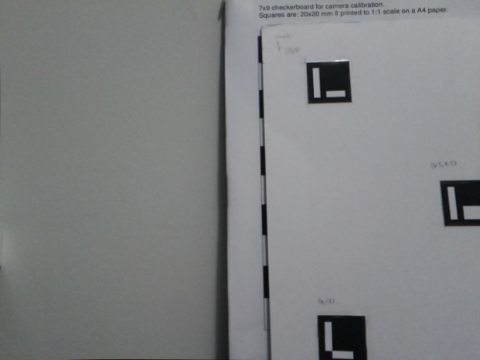

1 aruco_undist_1.png


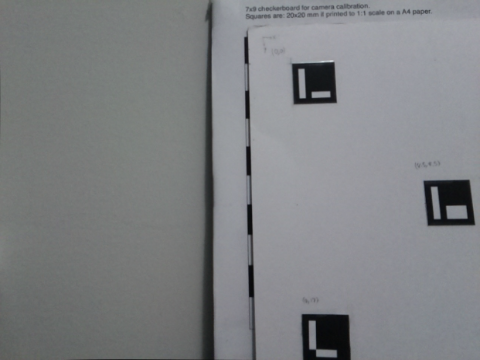

2 aruco_undist_10.png


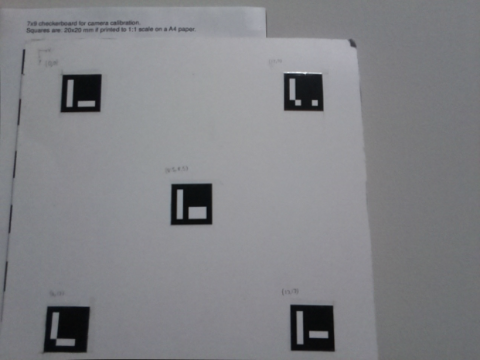

3 aruco_undist_11.png


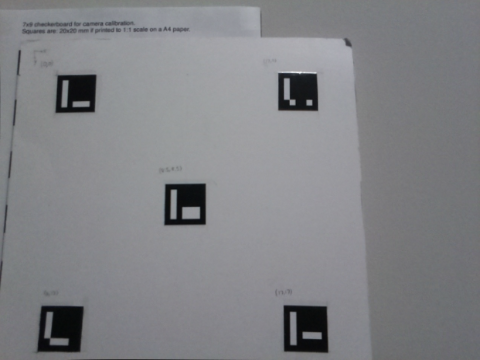

4 aruco_undist_12.png


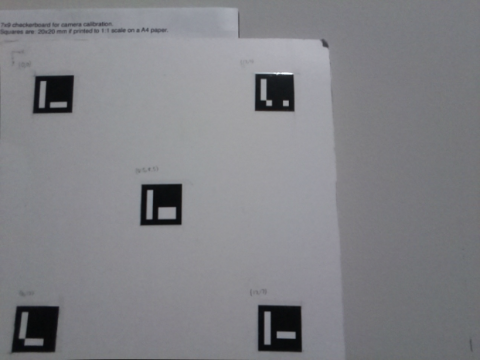

5 aruco_undist_13.png


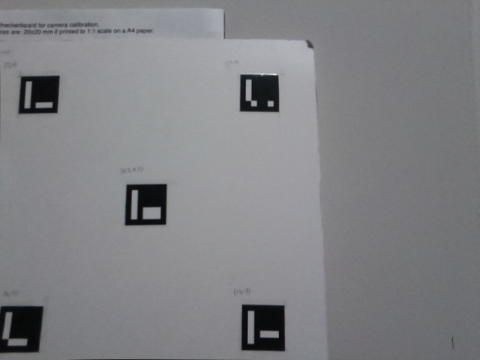

6 aruco_undist_15.png


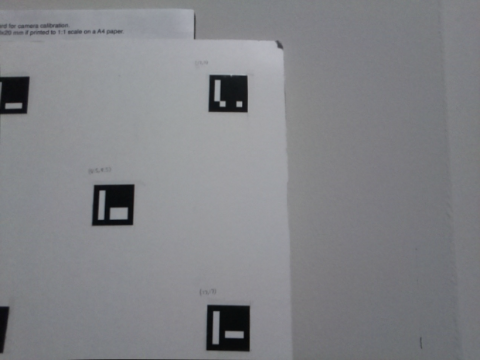

7 aruco_undist_14.png


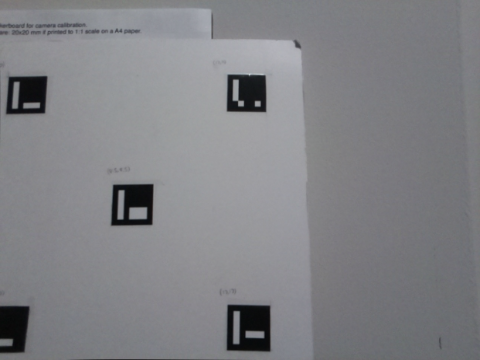

8 aruco_undist_16.png


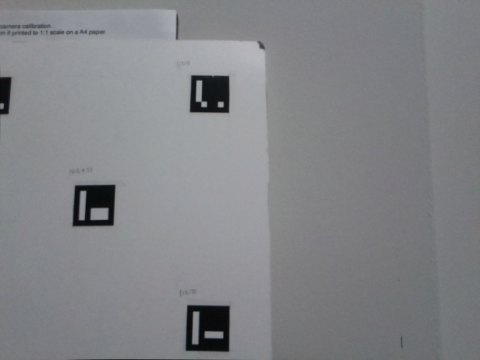

9 aruco_undist_18.png


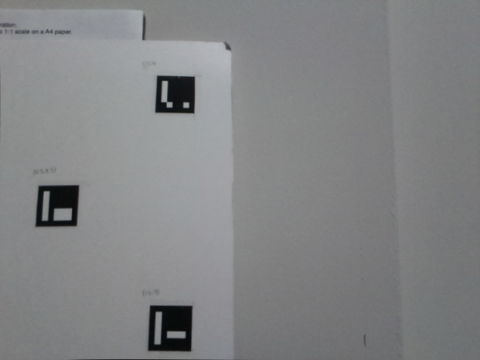

10 aruco_undist_17.png


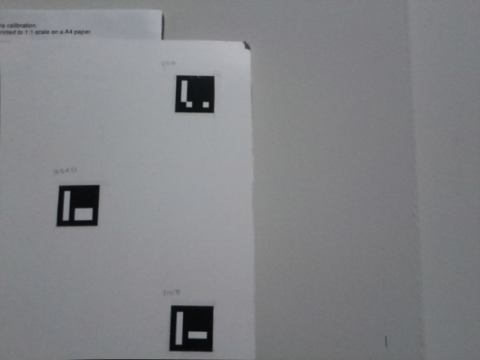

11 aruco_undist_2.png


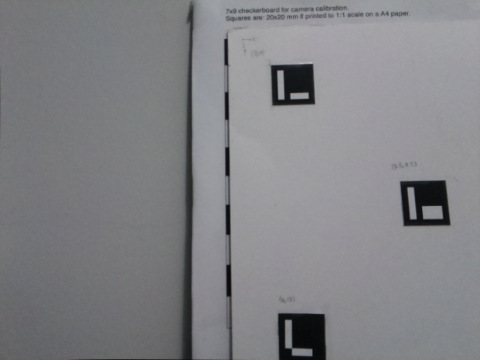

12 aruco_undist_19.png


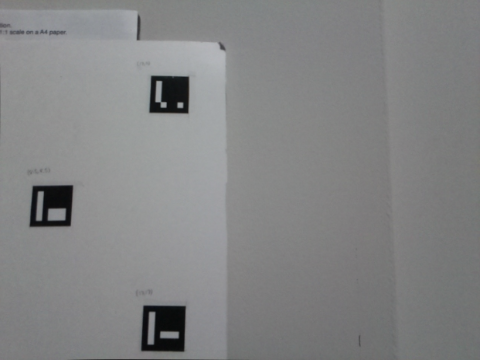

13 aruco_undist_20.png


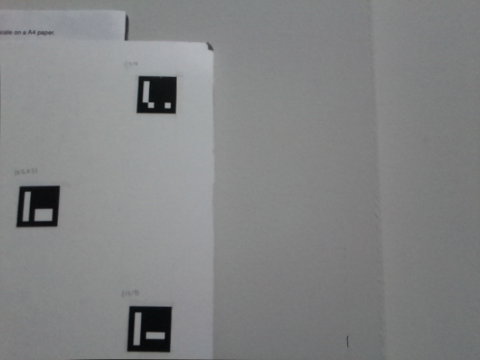

14 aruco_undist_21.png


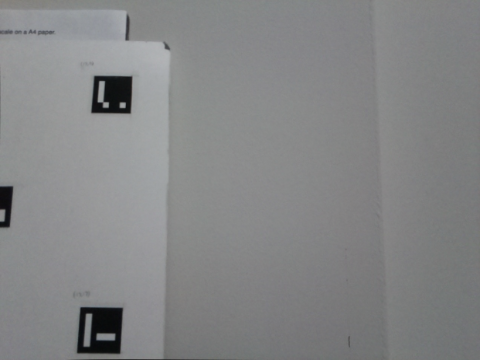

15 aruco_undist_23.png


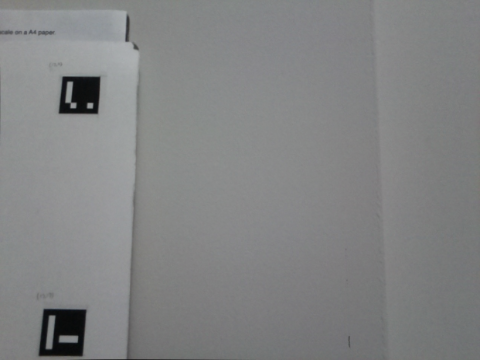

16 aruco_undist_22.png


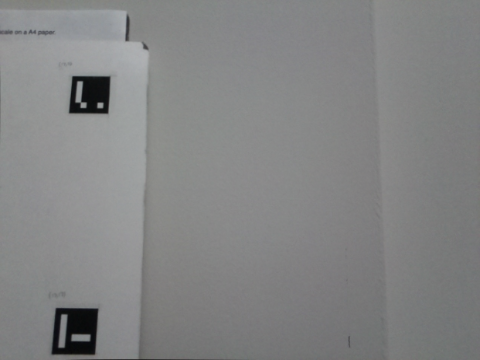

17 aruco_undist_24.png


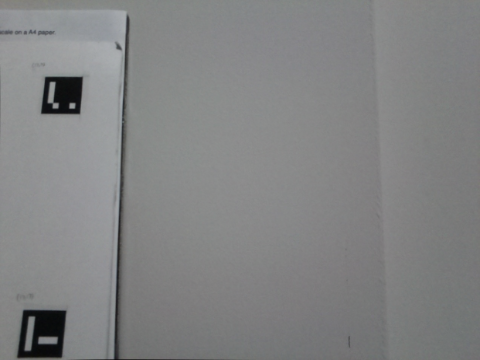

18 aruco_undist_25.png


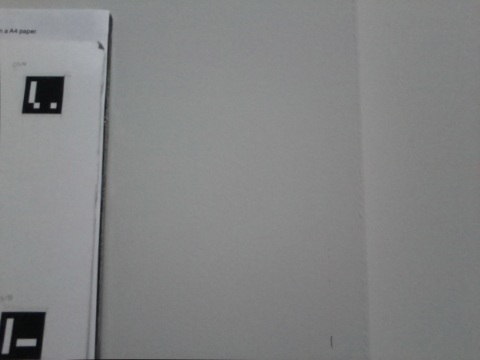

19 aruco_undist_27.png


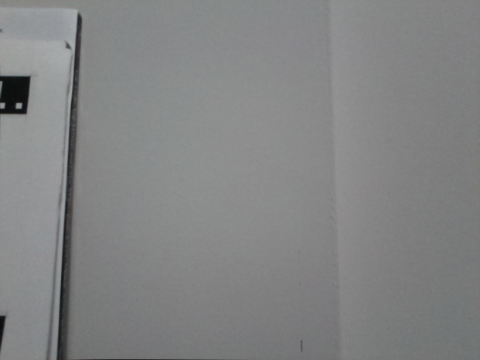

20 aruco_undist_26.png


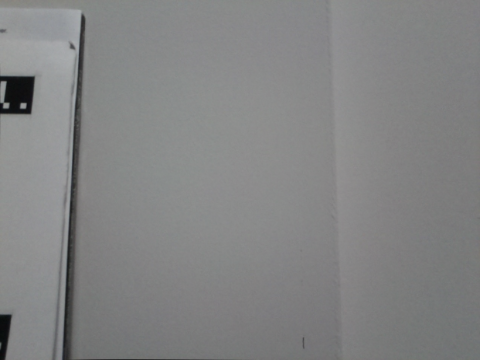

21 aruco_undist_4.png


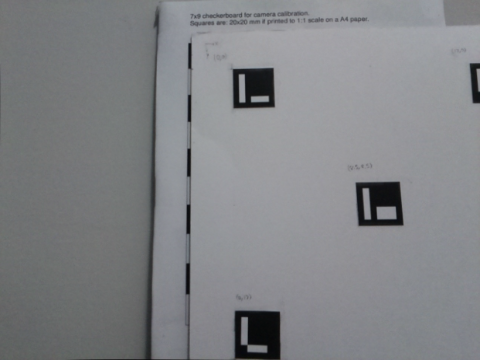

22 aruco_undist_3.png


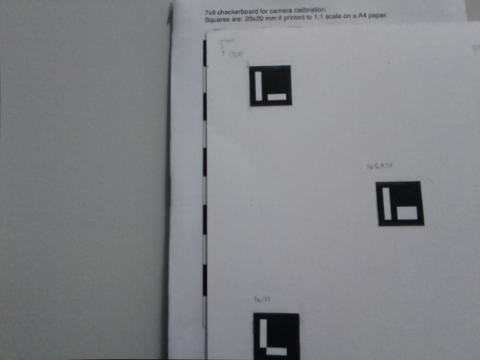

23 aruco_undist_6.png


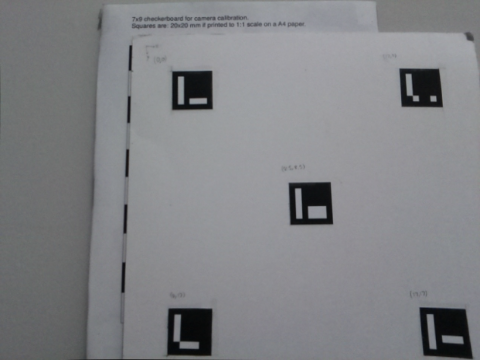

24 aruco_undist_5.png


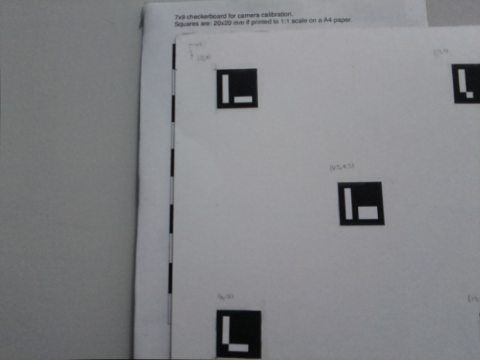

25 aruco_undist_7.png


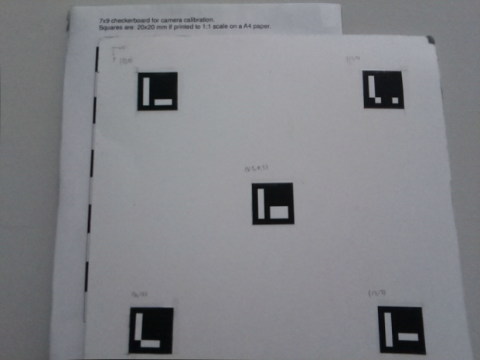

26 aruco_undist_8.png


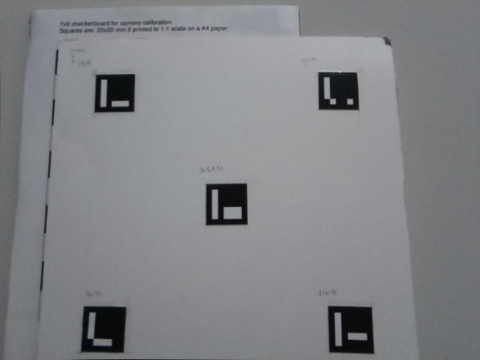

27 aruco_undist_9.png


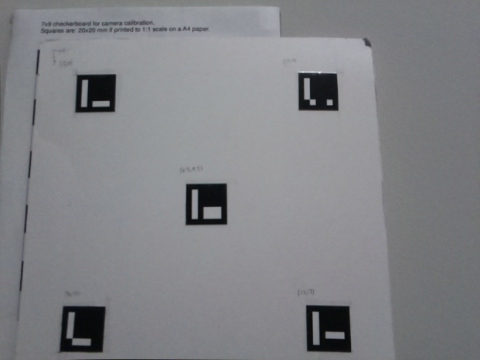

In [ ]:
for idx, f in enumerate(aruco_samples):
    print(idx, f)
    disp_file(f)

In [ ]:
# marker_31 = cv2.imread(laser_samples[31])
# marker_32 = cv2.imread(laser_samples[32])
# marker_33 = cv2.imread(laser_samples[33])
# marker_34 = cv2.imread(laser_samples[34])

# marker_31 = cv2.cvtColor(marker_31, cv2.COLOR_BGR2GRAY)
# marker_32 = cv2.cvtColor(marker_32, cv2.COLOR_BGR2GRAY)
# marker_33 = cv2.cvtColor(marker_33, cv2.COLOR_BGR2GRAY)
# marker_34 = cv2.cvtColor(marker_34, cv2.COLOR_BGR2GRAY)

In [ ]:
# fig, (ax1,ax2, ax3, ax4) = plt.subplots(nrows=1,ncols=4,figsize=(10,2))

# ax1.imshow(marker_31, cmap = plt.get_cmap('gray'))
# ax1.set_title("Image 1")
# ax2.imshow(marker_32, cmap = plt.get_cmap('gray'))
# ax2.set_title("Image 2")
# ax3.imshow(marker_33, cmap = plt.get_cmap('gray'))
# ax3.set_title("Image 3")
# ax4.imshow(marker_34, cmap = plt.get_cmap('gray'))
# ax4.set_title("Image 4")

# plt.show()

In [ ]:
imgs = []
for f in aruco_samples:
    img = cv2.imread(f)
    imgs.append(img)
    
    
mult_images = [i for idx, i in enumerate(imgs)]



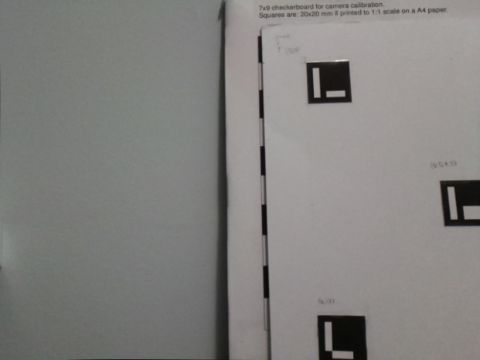

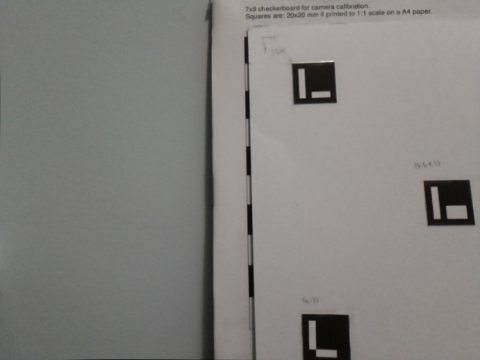

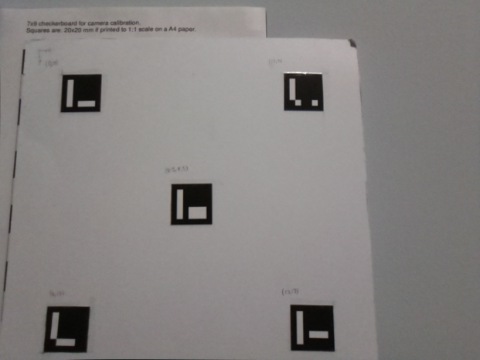

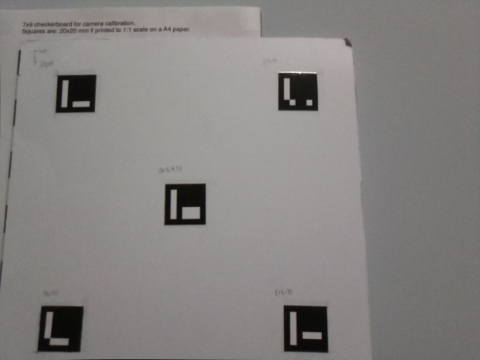

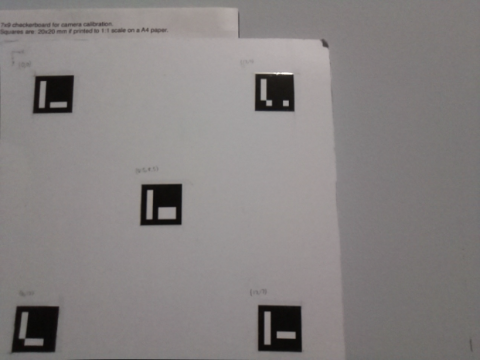

...

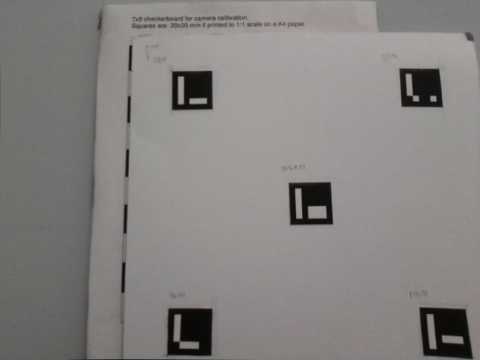

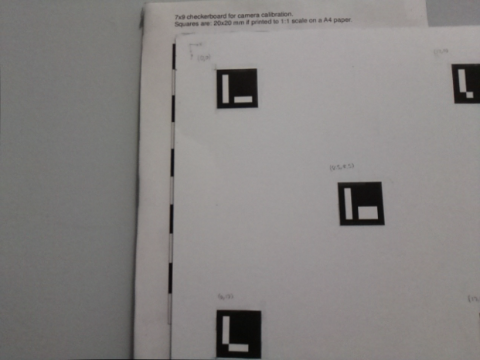

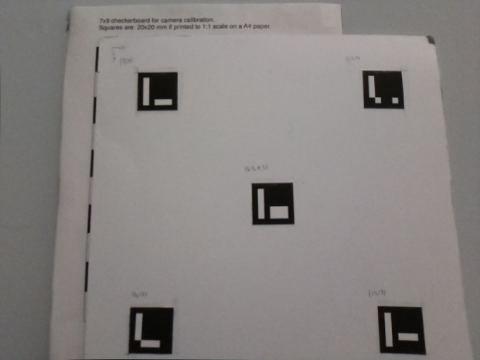

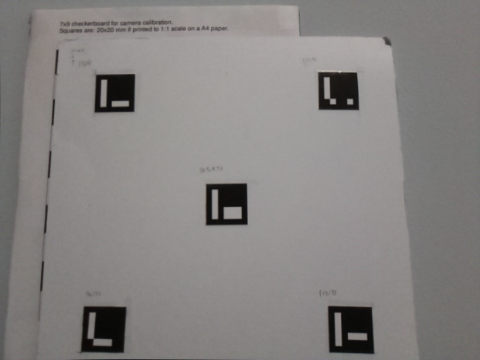

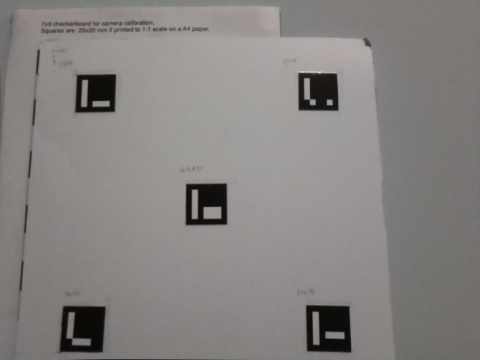

In [ ]:
for i in imgs:
    disp_img(i)

# Load Camera Matrix

In [ ]:
os.chdir("../../../")
print(os.getcwd())

/home/abhi/Code/3D-Scanner


In [ ]:
with np.load('res/cal_out/cam_params.npz') as X:
    camera_matrix, dist_coeffs = [X[i] for i in ('mtx','dist')]

# Get pose of an image

In [ ]:
def customAruco():
    # define an empty custom dictionary with 
    aruco_dict = cv2.aruco.custom_dictionary(0, 5, 1)
    # add empty bytesList array to fill with 3 markers later
    aruco_dict.bytesList = np.empty(shape = (5, 4, 4), dtype = np.uint8)
    # add new marker(s)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1]], dtype = np.uint8)
    aruco_dict.bytesList[0] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[0,1,0,0,1]], dtype = np.uint8)
    aruco_dict.bytesList[1] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[0,1,1,1,0]], dtype = np.uint8)
    aruco_dict.bytesList[2] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1],[1,0,0,0,0]], dtype = np.uint8)
    aruco_dict.bytesList[3] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1],[1,0,1,1,1]], dtype = np.uint8)
    aruco_dict.bytesList[4] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    # adjust dictionary parameters for better marker detection
    parameters =  cv2.aruco.DetectorParameters_create()
    parameters.cornerRefinementMethod = 3
    parameters.errorCorrectionRate = 0.2
    return aruco_dict, parameters

In [ ]:
frame = imgs[0]

In [ ]:
aruco_dict, arucoParams = customAruco()

In [ ]:
h,w = 480, 640
new_mtx, roi = cv2.getOptimalNewCameraMatrix(camera_matrix,dist_coeffs,(w,h),1,(w,h))

In [ ]:
# frame = undistort_camera(frame, camera_matrix, new_mtx, roi, dist_coeffs, w, h)
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

In [ ]:
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)

In [ ]:
frame_rvecs = []
frame_tvecs = []

for i in range(0, len(ids)):  
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawDetectedMarkers(frame, corners, ids)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

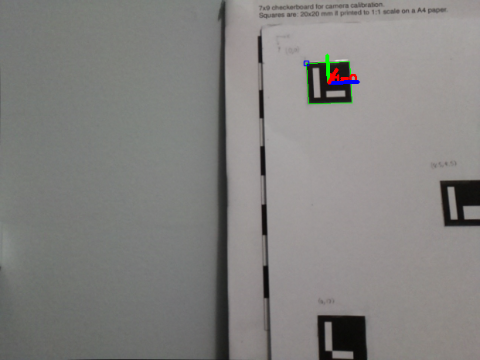

In [ ]:
disp_img(frame)

# Get relative transformations between markers

In [ ]:
# Transform from X to 0 where 0 is the marker placed at top left corner
frame = imgs[2]
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)
frame_rvecs = []
frame_tvecs = []

marker_order = {}

In [ ]:
for i in range(0, len(ids)):
    marker_order[ids[i][0]] = i
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

frame = cv2.aruco.drawDetectedMarkers(frame, corners, ids)

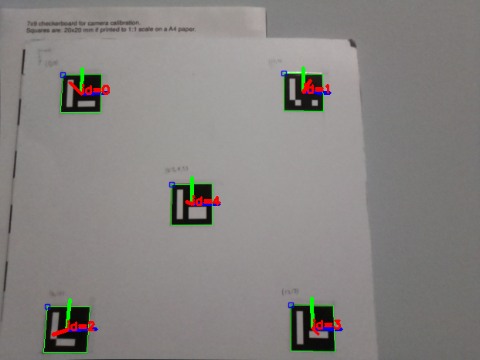

In [ ]:
disp_img(frame)

In [ ]:
print(ids)
print(marker_order)

[[1]
 [2]
 [3]
 [4]
 [0]]
{1: 0, 2: 1, 3: 2, 4: 3, 0: 4}


In [ ]:
t_1_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[1]]).flatten()
t_2_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[2]]).flatten()
t_3_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[3]]).flatten()
t_4_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[4]]).flatten()

print(t_1_0) 
print(t_2_0)  
print(t_3_0)
print(t_4_0)

[-17.03332392   0.07640195   0.48512037]
[ -0.20607315 -16.85089935   3.16841939]
[-17.18770291 -16.88283019   2.98734751]
[-8.58334423 -8.3571146   1.89874822]


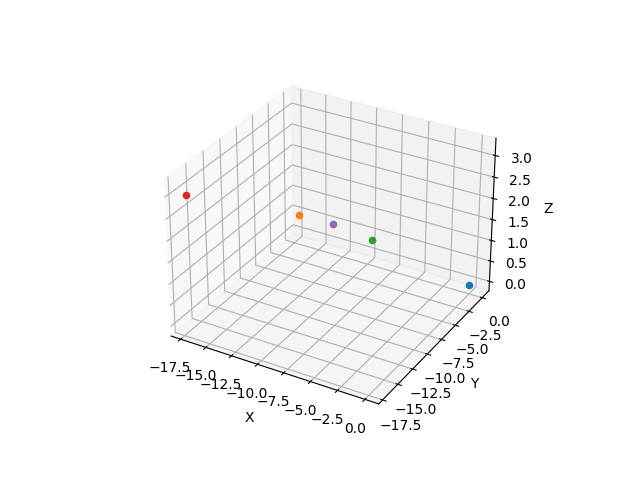

In [ ]:
tpts = [np.array([0, 0,0]), t_1_0, t_2_0, t_3_0, t_4_0]

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')

for pt in tpts:
    ax.scatter(pt[0],pt[1],pt[2])

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.show()

In [ ]:
#https://stackoverflow.com/questions/51270649/aruco-marker-world-coordinates



# Get pose of camera with one marker

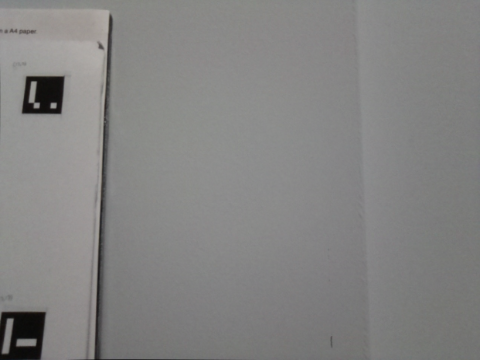

In [ ]:
frame = imgs[18]
disp_img(frame)

In [ ]:
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)
frame_rvecs = []
frame_tvecs = []

marker_order = {}

In [ ]:
print(ids)

[[1]]


In [ ]:
for i in range(0, len(ids)):
    marker_order[ids[i][0]] = i
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

frame = cv2.aruco.drawDetectedMarkers(frame, corners, ids)

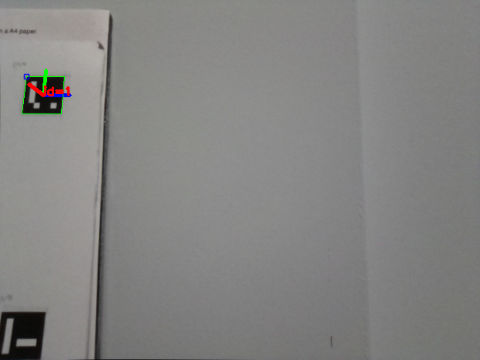

In [ ]:
disp_img(frame)

In [ ]:
#temporary changes so that we only work with one marker
rvec = frame_rvecs[0].flatten()
tvec = frame_tvecs[0].flatten()

print(rvec)
print(tvec)

[ 2.94825035  0.01078355 -0.06987148]
[-14.36840034  -5.97024325  29.91164026]


In [ ]:
dst, jac = cv2.Rodrigues(rvec)

print(dst)

[[ 0.99886121  0.01177606 -0.04623436]
 [ 0.00271093 -0.98150353 -0.19142484]
 [-0.04763342  0.19108151 -0.98041772]]


In [ ]:
extrinsics = np.eye(4)
extrinsics[:3, :3] = dst
extrinsics[:3, 3] = tvec

ex_i = np.linalg.inv(extrinsics)

print(extrinsics)
print("-------------------------------------------------------------------------------------")
print(ex_i)
print("-------------------------------------------------------------------------------------")
print(ex_i@extrinsics)
print("-------------------------------------------------------------------------------------")

# Alternative way to get inverse of 4x4 
ht = np.eye(4)
ht[:3, :3] = dst.transpose()
ht[:3, 3] = -dst.transpose()@tvec

print(ht)

[[ 9.98861206e-01  1.17760626e-02 -4.62343604e-02 -1.43684003e+01]
 [ 2.71092907e-03 -9.81503531e-01 -1.91424842e-01 -5.97024325e+00]
 [-4.76334189e-02  1.91081511e-01 -9.80417724e-01  2.99116403e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
-------------------------------------------------------------------------------------
[[ 9.98861206e-01  2.71092907e-03 -4.76334189e-02  1.57930163e+01]
 [ 1.17760626e-02 -9.81503531e-01  1.91081511e-01 -1.14061731e+01]
 [-4.62343604e-02 -1.91424842e-01 -9.80417724e-01  2.75187356e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
-------------------------------------------------------------------------------------
[[ 1.00000000e+00 -1.67911222e-18  1.00398075e-17  1.77635684e-15]
 [-1.68291359e-18  1.00000000e+00 -2.90061864e-18  0.00000000e+00]
 [ 9.90392820e-18 -3.01126769e-17  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
---------------------

### Plotting transformed point from camera frame to world frame

[[ 0.96440291]
 [-1.17021744]
 [-0.83696963]
 [32.90557883]]


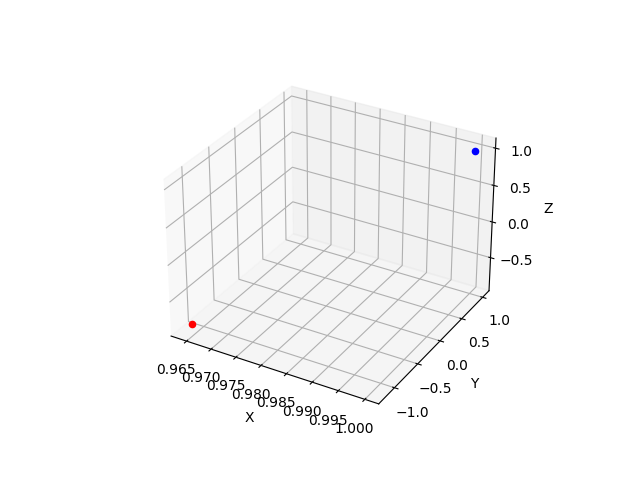

In [ ]:
point = np.array([[1],[1],[1],[1]]).reshape(4,1)
# tf_point = ex_i@point
tf_point = (point.transpose()@ex_i).transpose()
print(tf_point)
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')

ax.scatter(point[0], point[1], point[2], color='blue')
ax.scatter(tf_point[0], tf_point[1], tf_point[2], color='red')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.show()

# Get pose of camera over multiple images (for top left marker only)

0 aruco_undist_0.png


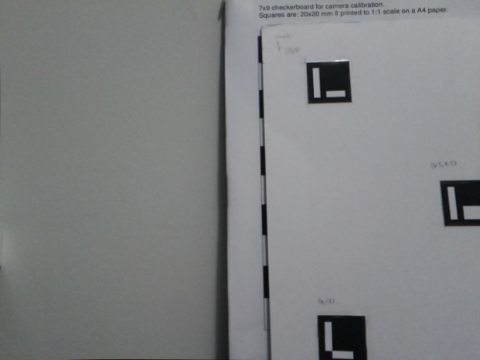

1 aruco_undist_1.png


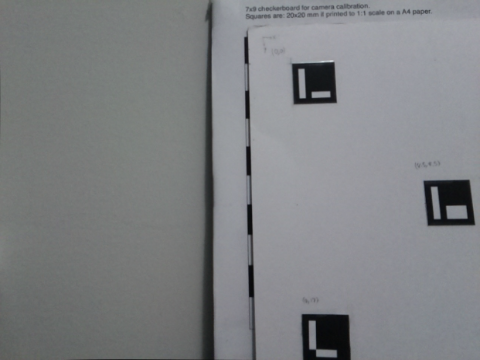

2 aruco_undist_10.png


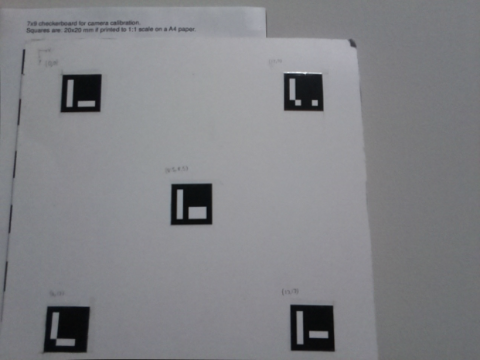

3 aruco_undist_11.png


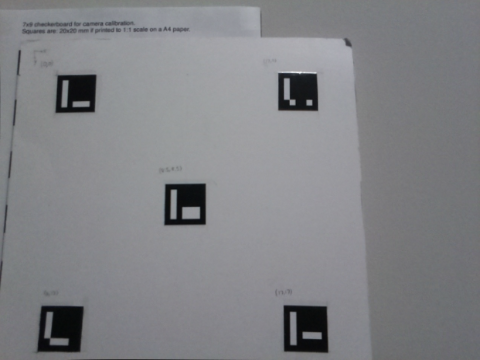

4 aruco_undist_12.png


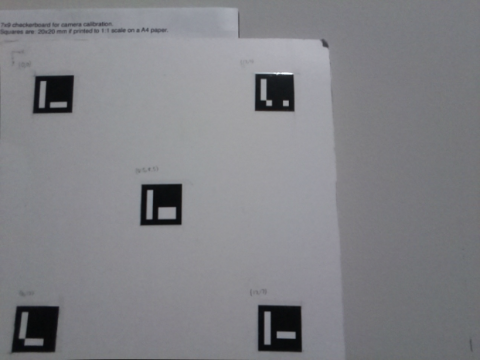

5 aruco_undist_13.png


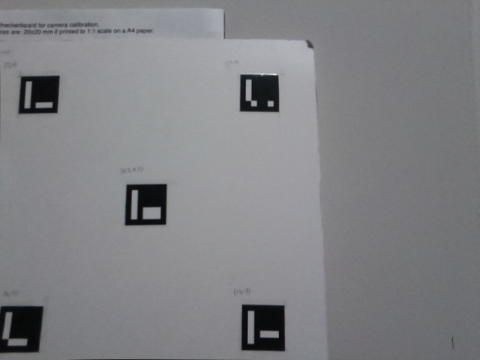

6 aruco_undist_15.png


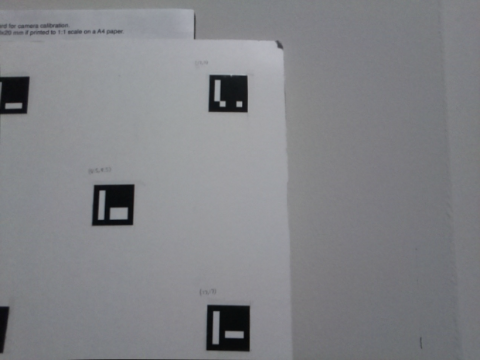

7 aruco_undist_14.png


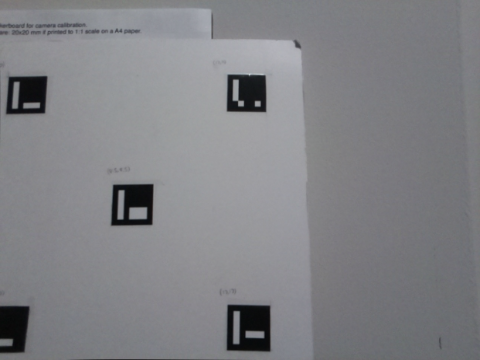

8 aruco_undist_16.png


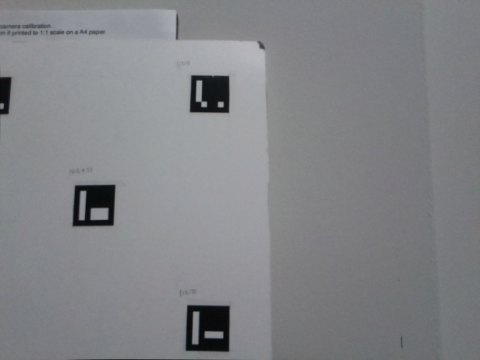

9 aruco_undist_18.png


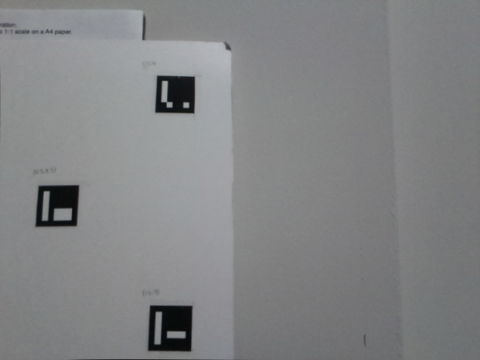

10 aruco_undist_17.png


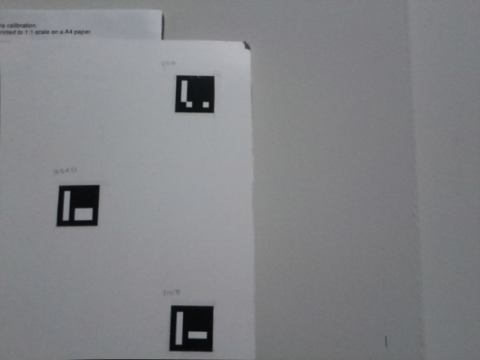

11 aruco_undist_2.png


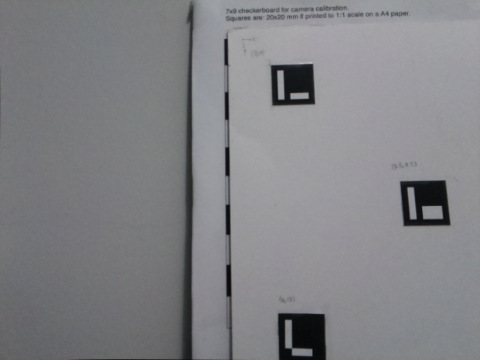

12 aruco_undist_19.png


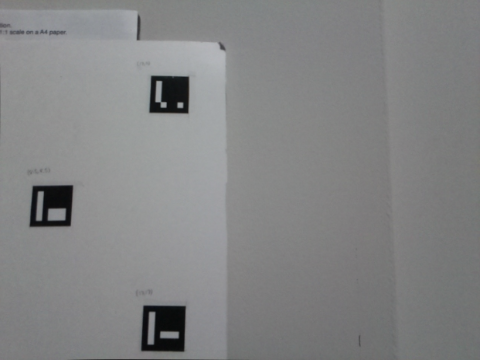

13 aruco_undist_20.png


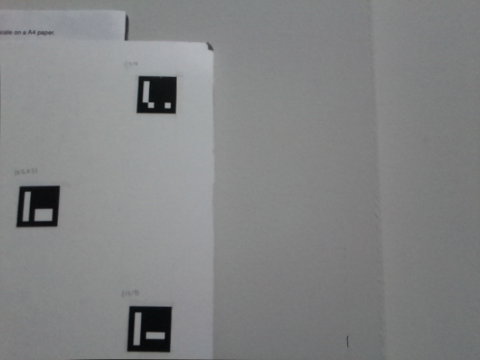

14 aruco_undist_21.png


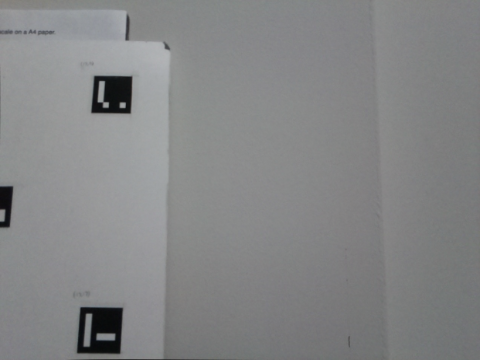

15 aruco_undist_23.png


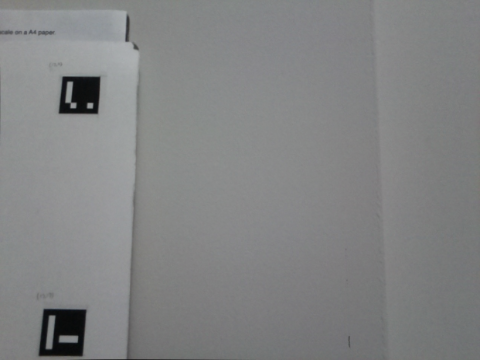

16 aruco_undist_22.png


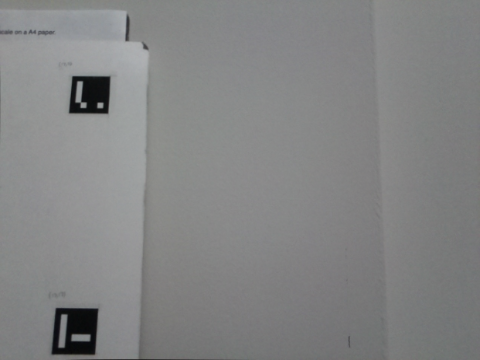

17 aruco_undist_24.png


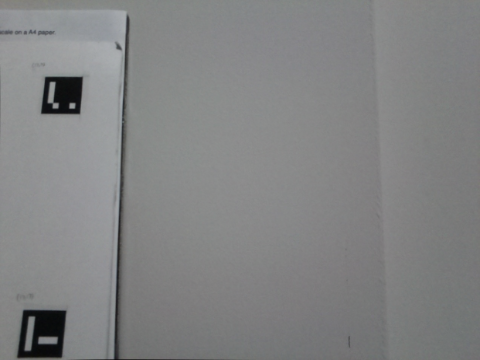

18 aruco_undist_25.png


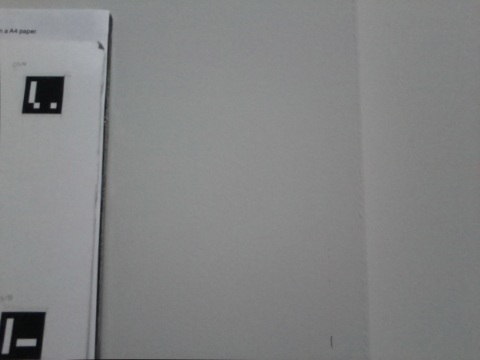

19 aruco_undist_27.png


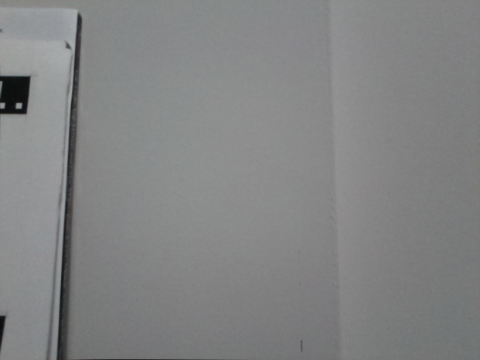

20 aruco_undist_26.png


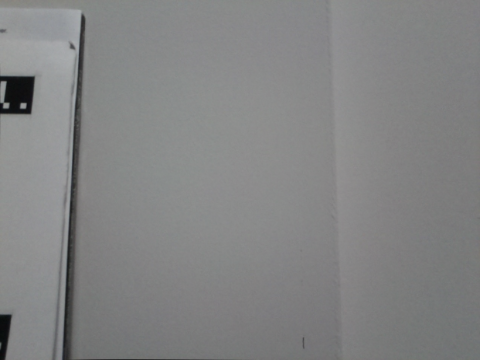

21 aruco_undist_4.png


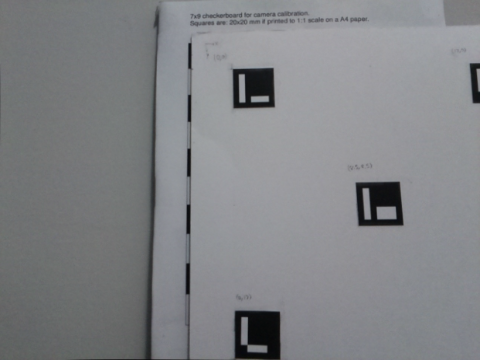

22 aruco_undist_3.png


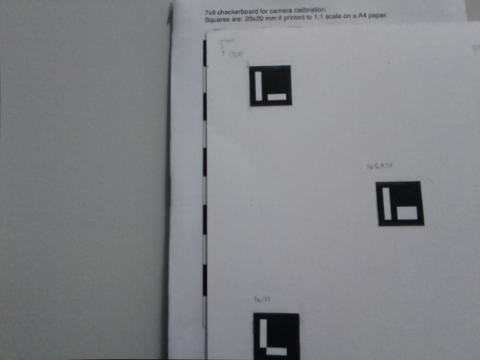

23 aruco_undist_6.png


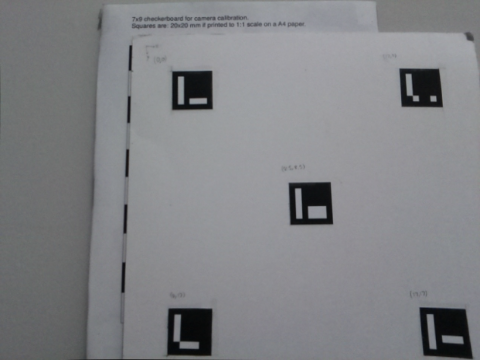

24 aruco_undist_5.png


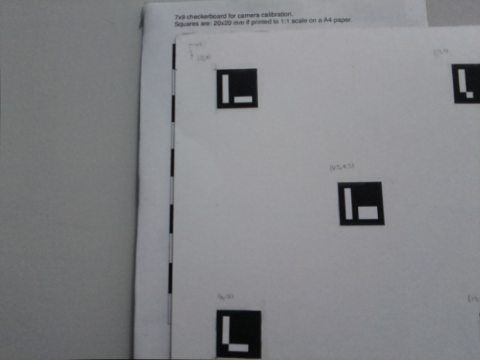

25 aruco_undist_7.png


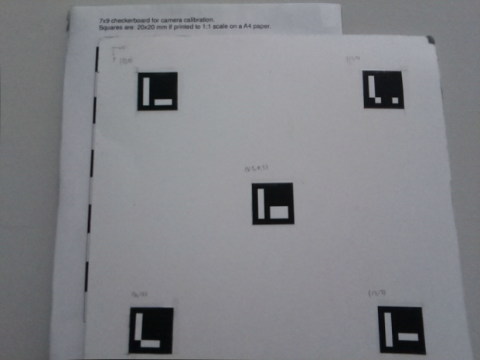

26 aruco_undist_8.png


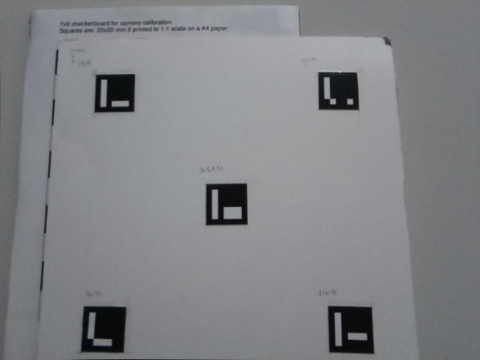

27 aruco_undist_9.png


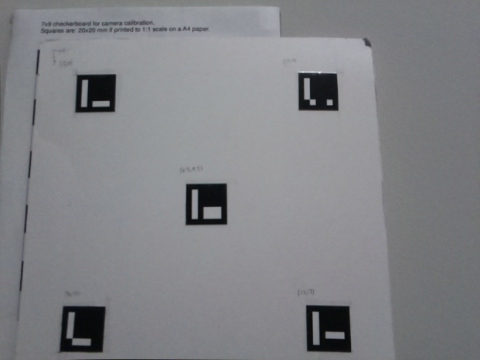

In [ ]:
for idx, f in enumerate(aruco_samples):
    print(idx, f)
    disp_file(f)

In [ ]:
# marker_31 = cv2.imread(laser_samples[31])
# marker_32 = cv2.imread(laser_samples[32])
# marker_33 = cv2.imread(laser_samples[33])
# marker_34 = cv2.imread(laser_samples[34])

# marker_31 = cv2.cvtColor(marker_31, cv2.COLOR_BGR2GRAY)
# marker_32 = cv2.cvtColor(marker_32, cv2.COLOR_BGR2GRAY)
# marker_33 = cv2.cvtColor(marker_33, cv2.COLOR_BGR2GRAY)
# marker_34 = cv2.cvtColor(marker_34, cv2.COLOR_BGR2GRAY)

In [ ]:
# fig, (ax1,ax2, ax3, ax4) = plt.subplots(nrows=1,ncols=4,figsize=(10,2))

# ax1.imshow(marker_31, cmap = plt.get_cmap('gray'))
# ax1.set_title("Image 1")
# ax2.imshow(marker_32, cmap = plt.get_cmap('gray'))
# ax2.set_title("Image 2")
# ax3.imshow(marker_33, cmap = plt.get_cmap('gray'))
# ax3.set_title("Image 3")
# ax4.imshow(marker_34, cmap = plt.get_cmap('gray'))
# ax4.set_title("Image 4")

# plt.show()

In [ ]:
imgs = []
for f in aruco_samples:
    img = cv2.imread(f)
    imgs.append(img)
    
    
mult_images = [i for idx, i in enumerate(imgs)]



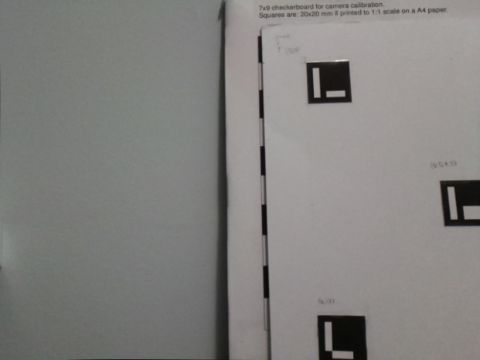

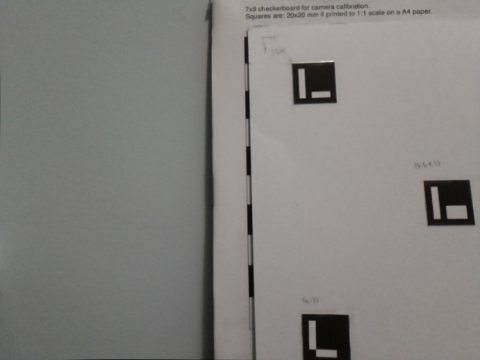

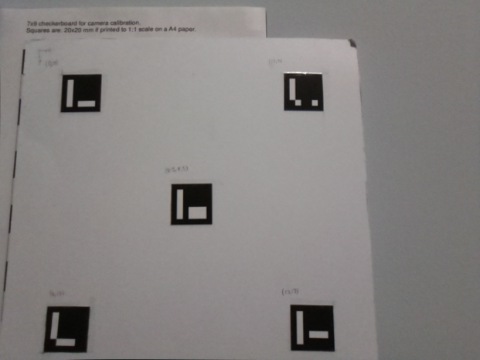

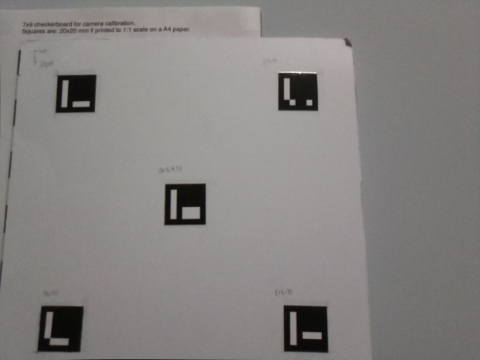

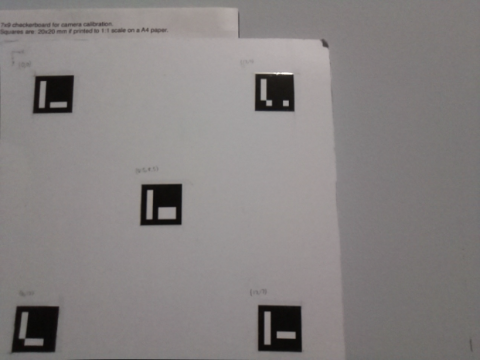

...

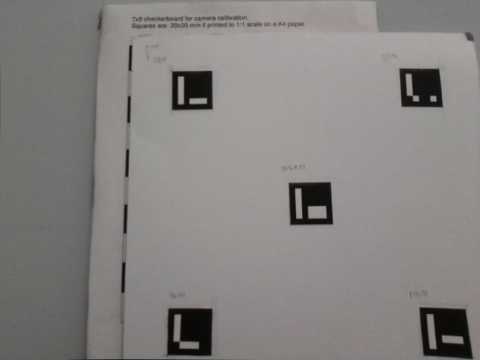

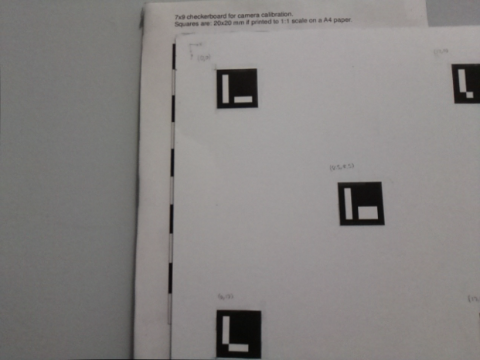

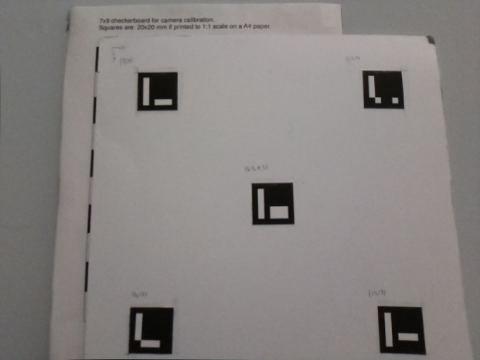

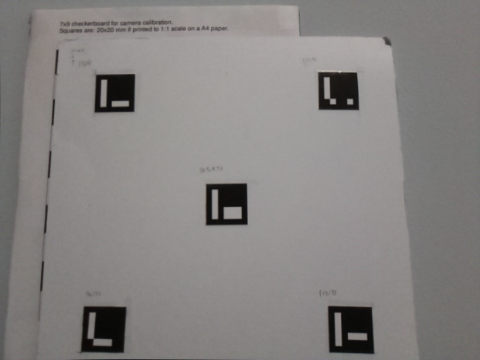

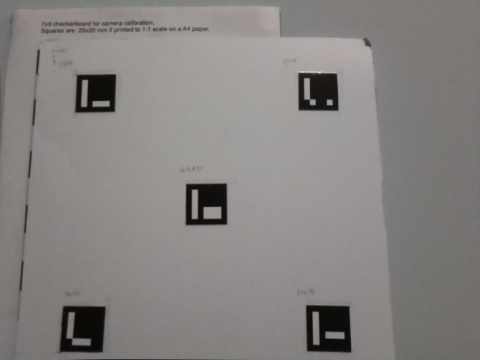

In [ ]:
for i in imgs:
    disp_img(i)

# Load Camera Matrix

In [ ]:
os.chdir("../../../")
print(os.getcwd())

/home/abhi/Code/3D-Scanner


In [ ]:
with np.load('res/cal_out/cam_params.npz') as X:
    camera_matrix, dist_coeffs = [X[i] for i in ('mtx','dist')]

# Get pose of an image

In [ ]:
def customAruco():
    # define an empty custom dictionary with 
    aruco_dict = cv2.aruco.custom_dictionary(0, 5, 1)
    # add empty bytesList array to fill with 3 markers later
    aruco_dict.bytesList = np.empty(shape = (5, 4, 4), dtype = np.uint8)
    # add new marker(s)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1]], dtype = np.uint8)
    aruco_dict.bytesList[0] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[0,1,0,0,1]], dtype = np.uint8)
    aruco_dict.bytesList[1] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[0,1,1,1,0]], dtype = np.uint8)
    aruco_dict.bytesList[2] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1],[1,0,0,0,0]], dtype = np.uint8)
    aruco_dict.bytesList[3] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    mybits = np.array([[1,0,0,0,0],[1,0,0,0,0],[1,0,0,0,0],[1,0,1,1,1],[1,0,1,1,1]], dtype = np.uint8)
    aruco_dict.bytesList[4] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
    # adjust dictionary parameters for better marker detection
    parameters =  cv2.aruco.DetectorParameters_create()
    parameters.cornerRefinementMethod = 3
    parameters.errorCorrectionRate = 0.2
    return aruco_dict, parameters

In [ ]:
frame = imgs[0]

In [ ]:
aruco_dict, arucoParams = customAruco()

In [ ]:
h,w = 480, 640
new_mtx, roi = cv2.getOptimalNewCameraMatrix(camera_matrix,dist_coeffs,(w,h),1,(w,h))

In [ ]:
# frame = undistort_camera(frame, camera_matrix, new_mtx, roi, dist_coeffs, w, h)
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

In [ ]:
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)

In [ ]:
frame_rvecs = []
frame_tvecs = []

for i in range(0, len(ids)):  
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawDetectedMarkers(frame, corners, ids)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

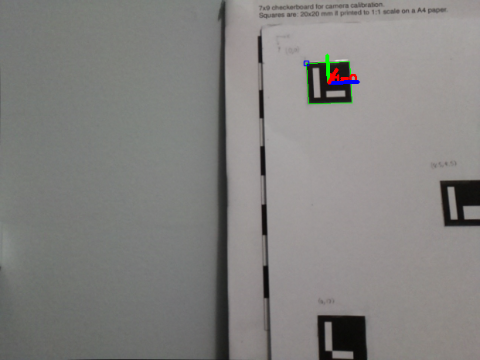

In [ ]:
disp_img(frame)

# Get relative transformations between markers

In [ ]:
# Transform from X to 0 where 0 is the marker placed at top left corner
frame = imgs[2]
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)
frame_rvecs = []
frame_tvecs = []

marker_order = {}

In [ ]:
for i in range(0, len(ids)):
    marker_order[ids[i][0]] = i
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

frame = cv2.aruco.drawDetectedMarkers(frame, corners, ids)

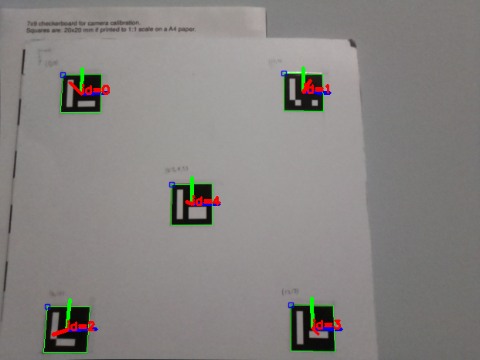

In [ ]:
disp_img(frame)

In [ ]:
print(ids)
print(marker_order)

[[1]
 [2]
 [3]
 [4]
 [0]]
{1: 0, 2: 1, 3: 2, 4: 3, 0: 4}


In [ ]:
t_1_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[1]]).flatten()
t_2_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[2]]).flatten()
t_3_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[3]]).flatten()
t_4_0 = (frame_tvecs[marker_order[0]] - frame_tvecs[marker_order[4]]).flatten()

print(t_1_0) 
print(t_2_0)  
print(t_3_0)
print(t_4_0)

[-17.03332392   0.07640195   0.48512037]
[ -0.20607315 -16.85089935   3.16841939]
[-17.18770291 -16.88283019   2.98734751]
[-8.58334423 -8.3571146   1.89874822]


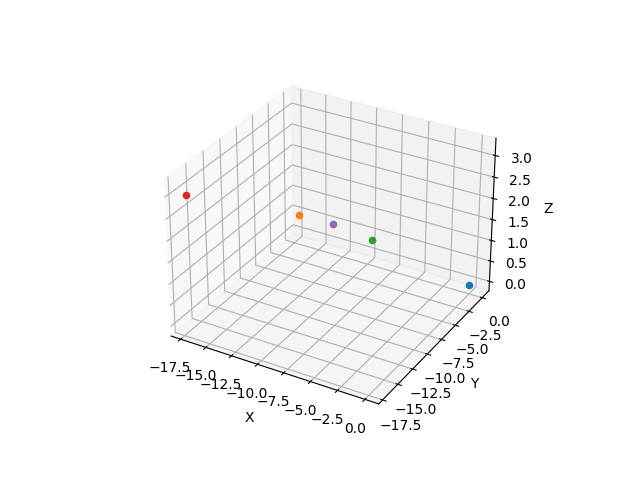

In [ ]:
tpts = [np.array([0, 0,0]), t_1_0, t_2_0, t_3_0, t_4_0]

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')

for pt in tpts:
    ax.scatter(pt[0],pt[1],pt[2])

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.show()

In [ ]:
#https://stackoverflow.com/questions/51270649/aruco-marker-world-coordinates



# Get pose of camera with one marker

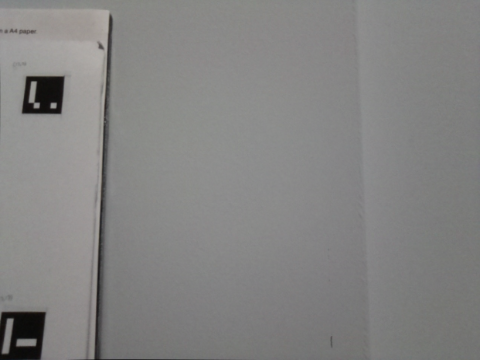

In [ ]:
frame = imgs[18]
disp_img(frame)

In [ ]:
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict, parameters=arucoParams)
frame_rvecs = []
frame_tvecs = []

marker_order = {}

In [ ]:
print(ids)

[[1]]


In [ ]:
for i in range(0, len(ids)):
    marker_order[ids[i][0]] = i
    rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], 3, new_mtx, dist_coeffs)
    frame_rvecs.append(rvec)
    frame_tvecs.append(tvec)
    cv2.aruco.drawAxis(frame, new_mtx, dist_coeffs, rvec, tvec, 2)

frame = cv2.aruco.drawDetectedMarkers(frame, corners, ids)

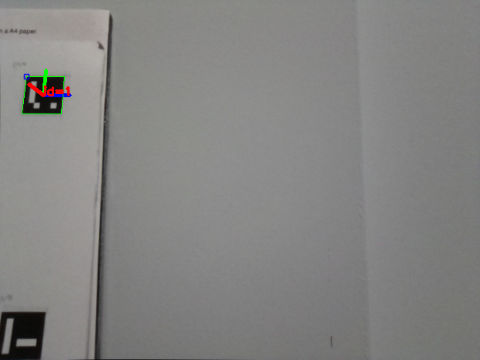

In [ ]:
disp_img(frame)

In [ ]:
#temporary changes so that we only work with one marker
rvec = frame_rvecs[0].flatten()
tvec = frame_tvecs[0].flatten()

print(rvec)
print(tvec)

[ 2.94825035  0.01078355 -0.06987148]
[-14.36840034  -5.97024325  29.91164026]


In [ ]:
dst, jac = cv2.Rodrigues(rvec)

print(dst)

[[ 0.99886121  0.01177606 -0.04623436]
 [ 0.00271093 -0.98150353 -0.19142484]
 [-0.04763342  0.19108151 -0.98041772]]


In [ ]:
extrinsics = np.eye(4)
extrinsics[:3, :3] = dst
extrinsics[:3, 3] = tvec

ex_i = np.linalg.inv(extrinsics)

print(extrinsics)
print("-------------------------------------------------------------------------------------")
print(ex_i)
print("-------------------------------------------------------------------------------------")
print(ex_i@extrinsics)
print("-------------------------------------------------------------------------------------")

# Alternative way to get inverse of 4x4 
ht = np.eye(4)
ht[:3, :3] = dst.transpose()
ht[:3, 3] = -dst.transpose()@tvec

print(ht)

[[ 9.98861206e-01  1.17760626e-02 -4.62343604e-02 -1.43684003e+01]
 [ 2.71092907e-03 -9.81503531e-01 -1.91424842e-01 -5.97024325e+00]
 [-4.76334189e-02  1.91081511e-01 -9.80417724e-01  2.99116403e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
-------------------------------------------------------------------------------------
[[ 9.98861206e-01  2.71092907e-03 -4.76334189e-02  1.57930163e+01]
 [ 1.17760626e-02 -9.81503531e-01  1.91081511e-01 -1.14061731e+01]
 [-4.62343604e-02 -1.91424842e-01 -9.80417724e-01  2.75187356e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
-------------------------------------------------------------------------------------
[[ 1.00000000e+00 -1.67911222e-18  1.00398075e-17  1.77635684e-15]
 [-1.68291359e-18  1.00000000e+00 -2.90061864e-18  0.00000000e+00]
 [ 9.90392820e-18 -3.01126769e-17  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
---------------------

### Plotting transformed point from camera frame to world frame

[[ 0.96440291]
 [-1.17021744]
 [-0.83696963]
 [32.90557883]]


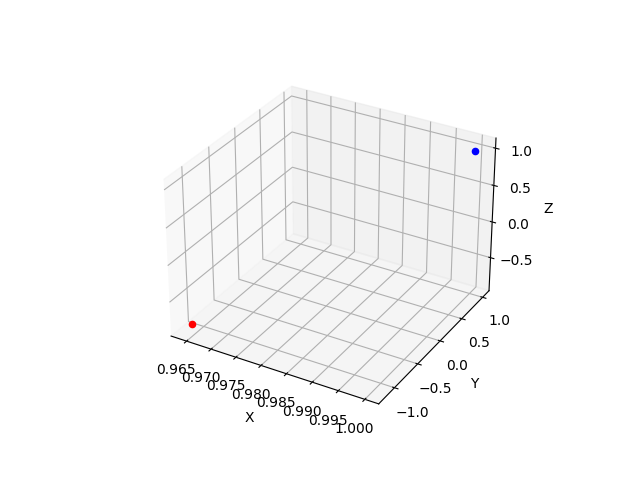

In [ ]:
point = np.array([[1],[1],[1],[1]]).reshape(4,1)
# tf_point = ex_i@point
tf_point = (point.transpose()@ex_i).transpose()
print(tf_point)
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')

ax.scatter(point[0], point[1], point[2], color='blue')
ax.scatter(tf_point[0], tf_point[1], tf_point[2], color='red')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.show()

# Get pose of camera over multiple images (for top left marker only)